## Configuración inicial

A continuación se importan las librerías necesarias para el funcionamiento del notebook. 

In [1]:
#plots and data
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

#metrics and transformations
from sklearn.preprocessing import MinMaxScaler,StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn import metrics

#Model 
from sklearn.neural_network import ELMRegressor
sns.set()

In [3]:
def plot_predict_test(df_test_y,testPredict,lag):
        ### Resultado predicción datos de entrenamiento
    print(testPredict.flatten())
    fig, ax = plt.subplots(figsize=[15,8])
    sns.lineplot(df_test_y.flatten(),label="real")
    sns.lineplot(testPredict.flatten(),label="predicción")
    plt.title("Comparación valor real y predicción")
    plt.ylabel("value")

In [4]:
def createLagFeature(name_features,lag,df):
    for name_feature in name_features:
        for i in range(1,lag+1):
            df[name_feature+"lag"+str(i)]=df[name_feature].shift(i)
    return df

In [5]:
#function to measure the performance
def timeseries_evaluation_metrics_func(y_true, y_pred,flag):
    def mean_absolute_percentage_error(y_true, y_pred): 
        epsilon=0.1e-5
        y_true, y_pred = np.array(y_true), np.array(y_pred)
        return np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    
    if flag : print(f'R2 is : {metrics.r2_score(y_true, y_pred)}',end='\n\n')
    else:
        print('Evaluation metric results:')
        print(f'MSE is : {metrics.mean_squared_error(y_true, y_pred)}')
        print(f'MAE is : {metrics.mean_absolute_error(y_true, y_pred)}')
        print(f'RMSE is : {np.sqrt(metrics.mean_squared_error(y_true, y_pred))}')
        print(f'MAPE is : {mean_absolute_percentage_error(y_true, y_pred)}')
        
    return {"MSE":metrics.mean_squared_error(y_true, y_pred),
           "MAE":metrics.mean_absolute_error(y_true, y_pred),
           "RMSE":np.sqrt(metrics.mean_squared_error(y_true, y_pred)),
           "MAPE":mean_absolute_percentage_error(y_true, y_pred)}

---

## Cargar y preparar los datos.

In [3]:
df = pd.read_csv("../../Datasets/Datos_durante_pandemia/data_durante_vol_ve_in.csv")

df['Fecha'] = pd.to_datetime(df['Fecha'])
df = df.sort_values('Fecha', ascending=True)
df = df.rename(columns = {'Vol. Futuros': 'VolFuturos'})
df

,Fecha,VolFuturos,TRM,Precio Interno,VIX,EMV-ID,EPU
0,2020-01-01,1.289946,3277.14,975000.0,12.548403,1.89,186.06
1,2020-01-02,0.735046,3277.14,945000.0,12.470000,2.84,139.13
2,2020-01-03,0.591834,3258.84,940000.0,14.020000,1.33,108.10
3,2020-01-04,1.367154,3262.05,930000.0,14.646666,0.00,212.82
4,2020-01-05,1.505321,3262.05,920000.0,14.311970,0.86,173.76
...,...,...,...,...,...,...,...
913,2022-07-02,0.778572,4198.77,2270000.0,25.922916,11.11,130.95
914,2022-07-03,0.819483,4198.77,2270000.0,26.641413,23.06,135.95
915,2022-07-04,0.843804,4198.77,2270000.0,27.530000,15.98,309.83
916,2022-07-05,0.850985,4198.77,2280000.0,27.540000,18.90,116.59


---

## Desarrollo del modelo

In [7]:
#objects to scale the data 
sc=StandardScaler()
sc2=StandardScaler()

In [8]:
df_stats=df

In [9]:
#
len_data=df_stats.shape[0]

#get target
df_label=df_stats["VolFuturos"].values.reshape(len_data,1)
#get attributes
df_data=df_stats.drop(columns=["Fecha"])

#apply scale
#df_label=sc.fit_transform(df_label)
#df_data_normalize=sc2.fit_transform(df_data)


In [10]:
def Model(df_data,df_label,lag,estimators):
    delete_columns=list(df_data.columns)
    df_data_lags=createLagFeature(df_data.columns,lag,df_data) if lag>0 else df_data
    
    df_data_lags.drop(columns=delete_columns,inplace=True)
    df_data_lags=df_data_lags[lag:]
    df_label=df_label[lag:]

    #transform data
    df_data_lags=sc2.fit_transform(df_data_lags)
    
    #split data
    #last index of the train data
    seventy_percent=int(len_data*0.7)

    #split the data normalize
    
    df_train=df_data_lags[:seventy_percent]
    df_test=df_data_lags[seventy_percent:]

    #split labels
    
    df_train_y=df_label[:seventy_percent]
    df_test_y=df_label[seventy_percent:]
    #split labels normalize
    
    df_label_normalize=sc.fit_transform(df_label)
    df_train_y_normalize=df_label_normalize[:seventy_percent]
    df_test_y_normalize=df_label_normalize[seventy_percent:]
    


    #make model
    model=ELMRegressor(hidden_layer_sizes=(estimators,), activation='logistic', solver='adam')
    #fit the model with the train data
    history=model.fit(df_train,df_train_y_normalize)
   
    # make predictions
    trainPredict = model.predict(df_train)
    trainPredict = np.reshape(trainPredict,(len(trainPredict),1))
    # invert transformation
    trainPredict = sc.inverse_transform(trainPredict)
    
    trainY = df_train_y
    
    # make predictions
    testPredict = model.predict(df_test)
    # invert transformation
    testPredict = np.reshape(testPredict,(len(testPredict),1))
    testPredict = sc.inverse_transform(testPredict)
    testY = df_test_y
    print("len test: ",testY.shape)
    print("len PREDICT: ",testPredict.shape)

    plot_predict_test(df_train_y,trainPredict,lag)
    plot_predict_test(df_test_y,testPredict,lag)
    return [{"Fecha":df_stats.Fecha[lag:][:seventy_percent],"typeELM":["train"]*len(trainPredict.flatten()),"ELM" :trainPredict.flatten()}
            ,{"Fecha":df_stats.Fecha[lag:][seventy_percent:],"typeELM":["test"]*len(testPredict.flatten()),"ELM":testPredict.flatten()}]
    
    return {"train":timeseries_evaluation_metrics_func(trainY.flatten()+1, trainPredict.flatten()+1,False),
           "test":timeseries_evaluation_metrics_func(testY.flatten()+1, testPredict.flatten()+1,False)}

## Resltados 

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.00944694 1.10961582 1.03580199 0.94822516 0.94603994 1.34408617
 0.96251282 1.28265883 0.9469656  1.23709592 0.94788496 0.94786186
 0.95548689 0.93809713 0.8504914  0.85750765 0.77945083 0.72107367
 0.78054703 0.7010451  1.00599669 1.05893299 1.16341468 1.0295936
 0.99376444 1.06376729 1.28665071 0.88554554 1.13518101 0.86353019
 1.3461112  1.05624073 0.95035196 0.97312164 0.80177916 0.74267213
 0.79409495 0.83888315 0.82574738 0.77571304 0.74151686 1.43222309
 1.49952006 1.29184038 1.41068507 1.13489534 0.93206278 0.94654769
 1.36075759 1.70058099 1.36381851 1.82999828 1.34054054 1.1144326
 1.53288477 1.35849046 1.49757342 1.23191292 1.71791161 2.32056563
 2.43883238 2.24721694 2.97415454 2.36069113 2.26594757 1.8038248
 2.35684476 2.4939444  2.58833702 2.71913509 2.05970347 2.02673836
 1.68239424 2.20419408 2.65811445 2.90326137 2.98120503 2.45149051
 2.33012509 1.96687149 2.25037139 2.75335572 2.5182467  2.79103874
 3.01879044 2.32922229

Evaluation metric results:
MSE is : 1.4622732150734232
MAE is : 0.8752805266818536
RMSE is : 1.209244894582327
MAPE is : 42.85303781956264
Evaluation metric results:
MSE is : 1.512221594885664
MAE is : 1.02485435716814
RMSE is : 1.2297241946410846
MAPE is : 57.8800083339605


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.99938587 1.11116348 1.04859733 0.90776697 0.91151734 1.38246282
 0.94185515 1.24908529 0.90489062 1.26455884 0.94904555 0.90356026
 0.93898455 0.94886374 0.83253056 0.82297154 0.74864758 0.70469216
 0.76679022 0.65921402 1.0239645  1.07271741 1.1301032  0.9543068
 0.91904983 1.00374907 1.28101755 0.76900604 1.10171304 0.79777135
 1.27692325 0.94587634 0.83534974 0.88496301 0.73175355 0.67545201
 0.75544619 0.79979488 0.7795832  0.7043014  0.6883033  1.49239006
 1.46220579 1.19374541 1.38732105 1.13395169 0.85998903 0.88402717
 1.40217749 1.68669636 1.22824224 1.80484532 1.25071551 1.00290487
 1.39754534 1.23014952 1.38254    1.1137135  1.60622144 2.27004213
 2.35473373 2.03875887 3.066238   2.19337825 2.15173888 1.73929781
 2.36807239 2.4921793  2.61564327 2.7491942  1.90525467 2.01226546
 1.75647432 2.16017941 2.58112923 3.0397016  3.0767394  2.32477453
 2.27871535 1.97180505 2.28512028 2.82573442 2.56083322 2.83323827
 3.22973743 2.223111

Evaluation metric results:
MSE is : 1.4533168152016387
MAE is : 0.8606071051237993
RMSE is : 1.2055359037381006
MAPE is : 41.07515373112787
Evaluation metric results:
MSE is : 1.5273780079044623
MAE is : 1.0288929318495477
RMSE is : 1.2358713557261785
MAPE is : 57.974847858630966


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.9514824  1.01199019 0.97981171 0.87426367 0.87955797 1.29694819
 0.90144447 1.23533298 0.86235907 1.17661786 0.88570517 0.87713789
 0.88123888 0.8684969  0.77344079 0.77173024 0.65530235 0.62940104
 0.67925953 0.59251918 0.94297575 1.02094303 1.11867374 0.96467903
 0.97388025 1.00868108 1.27295981 0.79034275 1.13105859 0.82684442
 1.33443918 1.02074211 0.90910892 0.92256143 0.7133558  0.63744816
 0.73426138 0.76049478 0.74898438 0.67059963 0.65948078 1.40915867
 1.44198906 1.20842309 1.37039503 1.11019116 0.86681063 0.89859155
 1.33956567 1.65999725 1.24979468 1.79408696 1.32744303 1.15248619
 1.56141418 1.41769686 1.5660794  1.28822913 1.74452122 2.3442918
 2.39657425 2.08839828 3.06854421 2.23620926 2.17541245 1.78514072
 2.33908627 2.49342983 2.60496051 2.71590555 2.01161481 2.03313335
 1.74627708 2.22525449 2.62006525 2.94866621 3.08435236 2.36735022
 2.30463392 1.9100123  2.25236406 2.77147361 2.54658634 2.75516634
 3.23842752 2.226786

Evaluation metric results:
MSE is : 1.4691153009398037
MAE is : 0.8698418629872958
RMSE is : 1.2120706666444014
MAPE is : 41.973923142535725
Evaluation metric results:
MSE is : 1.4039216025385106
MAE is : 0.9742399118008923
RMSE is : 1.1848719772779297
MAPE is : 53.652468168273124


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.89294622 0.98694066 0.93615748 0.81067677 0.79788403 1.2982175
 0.85296556 1.18469321 0.7837108  1.15571779 0.83529586 0.80180262
 0.81123143 0.81376983 0.70484593 0.69219836 0.57556646 0.53731455
 0.61145535 0.50271622 0.90464571 0.99504726 1.10288045 0.90969662
 0.88472755 0.96138358 1.2546538  0.71296589 1.0664783  0.77631021
 1.30704556 0.95953542 0.80060175 0.81705613 0.61593279 0.54438091
 0.65234463 0.69760381 0.6756337  0.59419056 0.57740109 1.43497862
 1.48968515 1.1855523  1.34600258 1.08241985 0.80079361 0.81474489
 1.3517817  1.72102946 1.25596835 1.81185098 1.3184144  1.09761691
 1.50893415 1.2928063  1.51709703 1.10620895 1.55056327 2.25236796
 2.39395983 2.07651375 3.082102   2.26042403 2.17262613 1.69993032
 2.26494037 2.38008199 2.56666148 2.721787   1.94782061 1.79193151
 1.47690165 2.12453198 2.42965929 2.85366056 3.02016732 2.25482406
 2.1785343  1.77609803 2.11980639 2.71602914 2.48062023 2.73985712
 3.21705713 2.162463

Evaluation metric results:
MSE is : 1.4700777777592655
MAE is : 0.8645406955476722
RMSE is : 1.2124676398812735
MAPE is : 41.06129891779128
Evaluation metric results:
MSE is : 1.4512066583463068
MAE is : 0.9944087667002183
RMSE is : 1.2046603912913825
MAPE is : 55.20570830510524


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.92563165 1.01478214 0.95406355 0.85445604 0.85680062 1.32049504
 0.82710885 1.18011645 0.80168671 1.17027624 0.83520371 0.83067172
 0.8508574  0.84269367 0.72042955 0.71979803 0.61582015 0.58299267
 0.65767957 0.54308277 0.92438426 0.97117448 1.05029515 0.89320409
 0.91180195 0.99574686 1.22358239 0.69914618 1.08490681 0.78011539
 1.30180876 0.9559508  0.83189605 0.86425562 0.65512387 0.5848742
 0.68796091 0.7233574  0.69868237 0.62917855 0.61911681 1.42977433
 1.37791863 1.10033094 1.34431205 1.07202589 0.80107439 0.84897566
 1.33882051 1.60999638 1.15113406 1.78615724 1.27836469 1.08656799
 1.51859908 1.24787125 1.52124596 1.15604915 1.63982229 2.25990046
 2.30285119 2.01718822 3.10572984 2.14727066 2.15563579 1.71307134
 2.32745565 2.45441865 2.5575157  2.65967549 2.07842013 1.93706348
 1.63240903 2.20708983 2.6244525  3.00773232 3.14592642 2.36589142
 2.38185655 2.0382158  2.30482358 2.82027736 2.54863623 2.84227704
 3.26966315 2.194118

Evaluation metric results:
MSE is : 1.4662070490260157
MAE is : 0.8624107205579089
RMSE is : 1.210870368382188
MAPE is : 41.128741779185276
Evaluation metric results:
MSE is : 1.4553438333150661
MAE is : 0.9965497212983033
RMSE is : 1.206376323256995
MAPE is : 55.387263625096


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.01643917 1.1126247  1.04817639 0.92977742 0.92642583 1.41916739
 0.94163171 1.26185653 0.88813982 1.26652659 0.94636687 0.9138476
 0.93847148 0.94467872 0.82372994 0.81223293 0.71318153 0.68048807
 0.75880016 0.63941973 1.03035809 1.09093315 1.16210287 0.97365293
 0.97737185 1.07404101 1.33977356 0.7951871  1.1500179  0.87335379
 1.40155388 1.04482207 0.8964407  0.95049483 0.75505566 0.67437728
 0.77952754 0.82925346 0.79825947 0.72127979 0.70960672 1.56318309
 1.51943473 1.18225218 1.4031536  1.17240632 0.89619029 0.92079113
 1.45930077 1.75933164 1.2375902  1.84815322 1.36052589 1.109496
 1.55782286 1.31456519 1.51720778 1.14974892 1.65434909 2.36321359
 2.41952823 2.02932004 3.16448964 2.17744543 2.09738874 1.68359027
 2.33547878 2.46903608 2.57992669 2.70926702 2.03457172 1.92446038
 1.7091934  2.2559474  2.75443634 3.08722802 3.25108945 2.43840499
 2.41613489 2.11481763 2.46233091 3.03629379 2.68831063 2.96630356
 3.44479815 2.31920435

Evaluation metric results:
MSE is : 1.4660744946139548
MAE is : 0.878021670371357
RMSE is : 1.2108156319663017
MAPE is : 43.35254387226149
Evaluation metric results:
MSE is : 1.483397115920737
MAE is : 1.0121157195428365
RMSE is : 1.2179479118257632
MAPE is : 56.76632611147602


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.99273266 1.09500094 1.02188073 0.90989467 0.90630914 1.39242731
 0.92721302 1.30114461 0.89375304 1.2591643  0.91410413 0.90624607
 0.91456723 0.90305964 0.78788077 0.78814453 0.6721418  0.61535072
 0.69292593 0.58118071 0.98493746 1.05415163 1.1644953  0.99138506
 0.9650725  1.06118796 1.31788833 0.79710815 1.15212434 0.82975997
 1.37430667 1.03898594 0.90267101 0.92813906 0.70828209 0.63052444
 0.72026941 0.77316319 0.74905412 0.6715114  0.64225671 1.5082684
 1.50823827 1.24564061 1.45906908 1.15014247 0.88094091 0.91158494
 1.42735045 1.74484789 1.28911765 1.88687149 1.35410404 1.16158467
 1.57310193 1.34521267 1.57328633 1.19456713 1.66728564 2.34655888
 2.42694144 2.13724772 3.21381778 2.27816828 2.22872251 1.74959013
 2.32743653 2.43432468 2.63085616 2.72309276 1.96593284 1.82850073
 1.53696921 2.03403836 2.54888593 2.9379978  3.10740383 2.34233765
 2.3411936  1.83636562 2.14230725 2.78474931 2.46822706 2.81885116
 3.34323653 2.182069

Evaluation metric results:
MSE is : 1.4673461477347722
MAE is : 0.8694160987184614
RMSE is : 1.211340640668335
MAPE is : 41.79707727004463
Evaluation metric results:
MSE is : 1.4474631133336768
MAE is : 0.991379952974664
RMSE is : 1.203105611878557
MAPE is : 54.91343931830293


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.98431766 1.10740018 1.03180951 0.90040737 0.90109765 1.38194796
 0.94473614 1.2853087  0.91567381 1.26281645 0.9344939  0.90940942
 0.92945875 0.9317363  0.82029429 0.81847002 0.71856679 0.66220189
 0.73087431 0.63119944 1.01760825 1.09663405 1.19514936 1.02947198
 0.98740677 1.07538251 1.34371249 0.84691036 1.16889412 0.88680376
 1.39971503 1.0658176  0.92220611 0.95717639 0.76336016 0.69200162
 0.77486347 0.82083415 0.80685885 0.73104488 0.69156759 1.52836254
 1.55903619 1.2587406  1.44218544 1.17270186 0.90801794 0.93107012
 1.44128762 1.77961717 1.32122557 1.85938325 1.35764315 1.15577294
 1.54852771 1.34383859 1.56306806 1.16269149 1.59528125 2.28782873
 2.40185173 2.08454409 3.13304566 2.22792564 2.12811816 1.71864208
 2.31521231 2.38987019 2.51534778 2.7156383  1.99339698 1.7567933
 1.6164732  2.17784016 2.55306124 2.90186119 3.08519043 2.28547543
 2.22321689 1.85065155 2.18164556 2.76134936 2.44083052 2.77020157
 3.26840147 2.144053

Evaluation metric results:
MSE is : 1.4678927240230428
MAE is : 0.8722470192295956
RMSE is : 1.2115662276669166
MAPE is : 42.20433924480645
Evaluation metric results:
MSE is : 1.3803024006593954
MAE is : 0.9603217810929836
RMSE is : 1.174862715664854
MAPE is : 52.353639688600374


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.92963484 1.02035431 0.96447105 0.85894591 0.84211422 1.28036017
 0.90419604 1.21598082 0.84870802 1.16319357 0.87921802 0.85652852
 0.85453986 0.84505461 0.75766639 0.75205693 0.63841688 0.58593646
 0.65823336 0.56089209 0.9282012  1.02284418 1.14083952 0.98324588
 0.93771377 1.0078015  1.26851555 0.82778023 1.09329789 0.83107977
 1.33252863 1.04183147 0.88967648 0.89634941 0.69361454 0.61518788
 0.70081431 0.7599689  0.74372871 0.67495463 0.641522   1.42300587
 1.49898693 1.26298166 1.38381893 1.10980527 0.88381142 0.88003142
 1.34866073 1.70085625 1.32838543 1.79996459 1.33318791 1.14454515
 1.51070733 1.35954704 1.53682544 1.20409493 1.62301392 2.27290303
 2.41062704 2.15710397 3.12724563 2.29908692 2.21851747 1.76855698
 2.27386221 2.4133323  2.68288064 2.80149883 2.06884231 1.91909411
 1.65252156 2.1755295  2.61213583 2.95481779 3.20248528 2.5552044
 2.45366314 1.93058044 2.23295398 2.84324338 2.60173411 2.91745529
 3.4561483  2.397762

Evaluation metric results:
MSE is : 1.4728246408637415
MAE is : 0.881005859442115
RMSE is : 1.213599868516696
MAPE is : 43.24456929960144
Evaluation metric results:
MSE is : 1.5252390006780163
MAE is : 1.032343286194513
RMSE is : 1.235005668277687
MAPE is : 58.354475904689075


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.9699688  1.0829377  1.00893557 0.88303581 0.87753063 1.38369565
 0.91205294 1.2499566  0.86268374 1.23898871 0.9015246  0.8709998
 0.89201473 0.89338575 0.775823   0.76804662 0.65951046 0.60526414
 0.68796729 0.57148898 0.98452419 1.05455501 1.14512554 0.96439537
 0.94118207 1.06054639 1.3214102  0.78621369 1.12258073 0.84574905
 1.38420888 1.04760934 0.88690873 0.92382205 0.71050754 0.62969324
 0.72747198 0.78895236 0.75686029 0.67892287 0.64939454 1.51996863
 1.50876284 1.19010866 1.39695919 1.14101764 0.87307506 0.89416033
 1.43471529 1.74657191 1.25298886 1.82453927 1.34038792 1.14537288
 1.56444937 1.36417388 1.57843999 1.24753401 1.71446175 2.41354414
 2.46466375 2.10748771 3.23553612 2.2473659  2.16476915 1.74387885
 2.35388617 2.50236087 2.6717252  2.74492321 2.02357832 1.91305336
 1.62499129 2.19092875 2.69212973 3.05692671 3.25651366 2.4295786
 2.36713529 1.96618543 2.33924968 2.97288271 2.59426326 2.93421137
 3.52721813 2.2437188

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.16254986 1.27766545 1.2140893  1.08391486 1.06930359 1.59733491
 1.14660776 1.45976156 1.07016871 1.44122397 1.12133466 1.07178574
 1.09172423 1.10407592 0.98845807 0.97086902 0.85509311 0.80160248
 0.89031321 0.77353032 1.18921988 1.27933756 1.36140214 1.16465399
 1.13205034 1.27164205 1.5296313  0.99766436 1.31370824 1.03817772
 1.56901743 1.26068156 1.0743869  1.10927662 0.91096524 0.82903138
 0.91696526 0.98919755 0.95083811 0.86642912 0.83777175 1.73575422
 1.75950152 1.40450442 1.58397968 1.34096618 1.07198611 1.0800654
 1.64066293 1.98428757 1.45860674 1.99404552 1.53433916 1.35506459
 1.71372356 1.52109016 1.7381473  1.39662051 1.78729447 2.52073057
 2.6438114  2.29785219 3.42296027 2.44722072 2.30020043 1.86003327
 2.48223867 2.6549049  2.72924824 2.78618028 2.11047444 1.95396551
 1.69733511 2.11922584 2.64316525 3.06574002 3.35111422 2.48509185
 2.38104724 1.92274107 2.2412176  2.91259589 2.5982934  2.9536733
 3.59379563 2.3139319

<ipython-input-3-72e029a2b199>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=[15,8])


[2.02379694 2.16890717 1.58711252 1.44559152 1.39382872 1.94656118
 2.50809783 1.92315853 1.69289098 2.18152591 1.62942971 1.34180709
 1.70232002 1.7326149  1.49693944 1.60605783 1.576912   1.46318629
 1.31733432 1.95302475 1.95794141 2.18919672 1.59739884 2.06700616
 1.59307756 1.51811835 1.36102843 1.38025904 1.2740899  1.22646662
 1.97347571 1.78034425 1.72570973 1.96612179 2.32043557 1.98594875
 2.55602729 2.15800824 1.94833512 1.66932417 1.72302454 1.34985122
 2.47563129 1.42648569 2.18715455 1.36859168 1.80204227 1.46978976
 2.61119122 1.61226895 1.84616245 1.68736231 1.67205514 1.78826696
 1.73361066 1.53367429 1.44437382 1.7102798  2.08438294 1.99401172
 1.95749367 2.09070882 2.24850334 1.44311959 2.08855296 2.08442215
 1.57218033 1.86789287 1.55578893 1.46146013 1.43232632 1.33109248
 1.3059889  1.71756699 1.86848211 1.60310682 1.98594079 1.77297314
 1.56464135 1.7175843  1.31933712 1.24960007 1.59534385 1.73127071
 1.78472424 1.23773961 1.66129112 1.68362447 1.73576954 2.0379

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.91425456 1.0391491  0.96673854 0.83093157 0.8194121  1.33723468
 0.85225916 1.18340752 0.80497192 1.19517262 0.85519003 0.81171643
 0.8375575  0.84206741 0.71535171 0.70433572 0.60561683 0.55121089
 0.63187052 0.50704612 0.9230516  0.98990077 1.06532578 0.88150034
 0.84559185 0.98071669 1.23451738 0.69814697 1.05079799 0.76966282
 1.28493138 0.95508047 0.78750898 0.83580928 0.63538008 0.5636462
 0.65248351 0.71694819 0.67944366 0.60279906 0.56982926 1.45627334
 1.43572017 1.08524434 1.31300017 1.06651667 0.78500682 0.80310949
 1.36479851 1.67567302 1.14763257 1.72072386 1.238831   1.05865168
 1.42538039 1.22163287 1.44172237 1.09005745 1.50517871 2.2237692
 2.29907422 1.92981521 3.09371086 2.06243623 1.94313648 1.54033656
 2.16808815 2.29734763 2.38187409 2.4486693  1.71936454 1.57587234
 1.37745244 1.82298704 2.27116949 2.71744543 2.99417685 2.1200922
 2.0836911  1.66272923 1.99850731 2.65889572 2.28706301 2.66111474
 3.32265424 1.96145543

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.94580509 1.05283347 0.97705612 0.86001003 0.85631321 1.34897045
 0.85574092 1.19240989 0.80879965 1.19486057 0.8640189  0.83800928
 0.86218108 0.86407893 0.7386864  0.73446608 0.63333028 0.59328233
 0.67772255 0.55119266 0.96140489 1.02143157 1.09704066 0.92334158
 0.93284204 1.0368854  1.29329715 0.76066378 1.09571596 0.8446736
 1.38772326 1.03561406 0.88286556 0.93423494 0.71330899 0.61607408
 0.72659268 0.78475595 0.76136175 0.68575136 0.66513712 1.51786027
 1.47350016 1.13824399 1.35059053 1.12188179 0.85710348 0.87909602
 1.40252355 1.69844339 1.20298959 1.78714333 1.32438364 1.08053022
 1.54949288 1.33213649 1.53060289 1.20814786 1.75177577 2.44872897
 2.45669827 2.07099582 3.25091335 2.19103627 2.1180303  1.71314301
 2.35557548 2.50842221 2.7472178  2.84538993 2.09197463 2.01071722
 1.59639998 2.37605203 2.86669751 3.24597753 3.49912196 2.64145382
 2.58549684 2.12190163 2.5599278  3.23256741 2.80533291 3.15269926
 3.85904825 2.451981

Evaluation metric results:
MSE is : 1.4843483551276104
MAE is : 0.89320757458064
RMSE is : 1.218338358227143
MAPE is : 44.94886897106324
Evaluation metric results:
MSE is : 1.5191586953239358
MAE is : 1.0298837815650228
RMSE is : 1.2325415592684636
MAPE is : 58.22955848901964


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[0.98730472 0.96476063 0.90738987 1.1633438  0.85920146 1.12769556
 0.89044566 1.19648051 0.99907403 0.96851963 0.91819084 0.9022176
 0.84974233 0.85354587 0.79698722 0.79221107 0.83638948 0.70988083
 0.9463265  1.00462927 1.04416709 0.93653714 0.95289052 0.99826691
 1.12118847 0.78854207 1.13327971 0.86881896 1.16881063 0.95647064
 0.9312749  0.92348209 0.77157191 0.75057906 0.83205287 0.86464943
 0.84889869 0.77637713 0.77395242 1.3309441  1.19918636 1.00387366
 1.31695242 1.12102258 0.86678844 0.89347047 1.26728878 1.4538554
 1.1408977  1.68623693 1.3098982  0.96399194 1.29193617 1.13227119
 1.49330996 1.42388656 1.92184627 2.5909486  2.67810151 2.47447517
 3.00383767 2.24922085 2.17560209 1.91726026 2.29461199 2.4914674
 2.68728539 2.7963518  2.39672052 2.12671816 1.76086033 2.15946292
 2.5219273  3.14177898 3.27898628 2.28756567 2.21203829 1.89031911
 2.20225866 2.86571291 2.96813445 3.09240236 3.0856587  2.15240524
 2.33508059 2.34191964

Evaluation metric results:
MSE is : 1.4156620581154566
MAE is : 0.8616681124240922
RMSE is : 1.1898159765759815
MAPE is : 41.93759841686792
Evaluation metric results:
MSE is : 1.5065785957223545
MAE is : 1.024679334584215
RMSE is : 1.2274276335989647
MAPE is : 57.63564898733413


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[0.97817339 0.94918676 0.89079813 1.20172603 0.81737794 1.12737321
 0.88607186 1.23476038 0.98830249 0.94516235 0.93224554 0.92026807
 0.84896749 0.86239663 0.82117655 0.80070805 0.85955352 0.70232841
 0.98568289 1.0152338  1.02843521 0.89897074 0.92422578 0.98564843
 1.11521688 0.73862967 1.08582286 0.84021627 1.16516499 0.92094505
 0.8886593  0.91826603 0.75337098 0.74504382 0.83787776 0.87740641
 0.8343793  0.76408325 0.75548966 1.40432106 1.20401031 0.9435838
 1.27548785 1.07437158 0.82845744 0.86141874 1.31240509 1.48044348
 1.09104032 1.67223169 1.2305626  0.86555502 1.2111794  0.99039605
 1.38126708 1.35756367 1.86895646 2.59199833 2.75060409 2.58603607
 3.25264907 2.34412369 2.23102515 1.89710713 2.26759316 2.41429397
 2.68748    2.85873941 2.41625635 2.20933432 1.62058846 1.97862675
 2.62851115 3.23281173 3.37011659 2.02282022 1.90132054 1.73693899
 2.21397651 2.83034742 2.91975156 3.07647413 3.08775915 1.88325256
 2.06276618 2.213457

 1.69026499]
Evaluation metric results:
MSE is : 1.3980041430894967
MAE is : 0.857674149379552
RMSE is : 1.182372252334051
MAPE is : 41.38921591360473
Evaluation metric results:
MSE is : 1.4755282051301468
MAE is : 1.007615698738977
RMSE is : 1.2147132192950512
MAPE is : 56.16599904903457


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.01618149 0.97830039 0.92025066 1.2373496  0.83836309 1.13022428
 0.8647541  1.26338875 1.00855171 0.97655543 0.95865164 0.95944309
 0.87496625 0.87375092 0.82553719 0.82079536 0.88774607 0.72764265
 1.0065628  1.03901399 1.05352157 0.89539683 0.92971311 1.01178286
 1.12863201 0.68532701 1.10538986 0.83137782 1.1762974  0.90863232
 0.85357284 0.86837514 0.73944925 0.74528284 0.83400711 0.87825659
 0.84561462 0.7644201  0.76846576 1.40896617 1.1910926  0.86770994
 1.22039369 1.04956611 0.81509117 0.87284136 1.31976756 1.46852664
 0.99866289 1.60630721 1.18188524 0.83231949 1.11325776 0.8835462
 1.27938049 1.3475252  1.81285872 2.50480599 2.66496031 2.50194125
 3.24287008 2.2763204  2.15650511 1.90861861 2.40937593 2.53376773
 2.70343266 2.98591377 2.61264645 2.38323425 1.83535336 2.16656508
 2.6678415  3.45992358 3.45543377 2.19451985 2.10056267 1.93385088
 2.22621604 2.9993927  3.13901106 3.22552755 3.16261458 2.06540177
 2.4089189  2.152528

Evaluation metric results:
MSE is : 1.387576515597375
MAE is : 0.853593055914829
RMSE is : 1.1779543775534667
MAPE is : 40.97029759992735
Evaluation metric results:
MSE is : 1.4922498979573022
MAE is : 1.0150788131046604
RMSE is : 1.2215768080465927
MAPE is : 56.68597663574428


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.00508163 0.98961806 0.87751372 1.18477437 0.85956034 1.1431379
 0.84515516 1.2215484  1.01453872 0.96137437 0.9030712  0.91201361
 0.85324925 0.83986968 0.78000375 0.76908706 0.84228166 0.67371446
 0.96753508 1.02993827 1.06231629 0.90424096 0.92033044 0.99973309
 1.12712241 0.74210937 1.07561759 0.84225042 1.1801649  0.9764913
 0.90053414 0.87786963 0.70892227 0.71587674 0.79864117 0.86182238
 0.82683597 0.75087023 0.72536653 1.39679126 1.25876805 0.97704831
 1.24808977 1.0692042  0.84606429 0.84572681 1.30749163 1.53212903
 1.13170471 1.64626229 1.25323333 0.93558958 1.22928768 1.03805856
 1.3924567  1.3560429  1.8617689  2.53101576 2.64494893 2.43002897
 3.14657617 2.2247361  2.04742368 1.81859284 2.33433364 2.50359841
 2.6466069  2.76149759 2.40748715 2.29806821 1.8067416  1.93449852
 2.57527242 3.50550749 3.59495706 2.10734443 1.97717999 1.77148083
 2.28630584 3.02362205 3.14561329 3.32788391 3.27153635 2.03886671
 2.3496077  2.1892362

Evaluation metric results:
MSE is : 1.3986623692950462
MAE is : 0.8620875425514855
RMSE is : 1.182650569396999
MAPE is : 42.13896059090873
Evaluation metric results:
MSE is : 1.4779226226428042
MAE is : 1.0113951531000116
RMSE is : 1.2156984094103291
MAPE is : 56.4161211401376


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[0.9270114  0.89431611 0.81159679 1.18339576 0.76284409 1.10938284
 0.81890424 1.24720926 0.96346504 0.89990369 0.87136706 0.86928942
 0.77940679 0.77810966 0.72589758 0.70520175 0.77619385 0.57730596
 0.92627729 0.98686578 1.0168907  0.8533317  0.89764504 1.00891947
 1.12742648 0.65378121 1.09412518 0.81199087 1.16142142 0.90578707
 0.84877577 0.85800702 0.66734121 0.64183641 0.7370082  0.80639286
 0.75538649 0.66889496 0.6647019  1.42512065 1.21393845 0.88861851
 1.26583471 1.11373903 0.80842526 0.81841705 1.35413413 1.54434161
 1.05953885 1.68105225 1.26755636 0.89667825 1.20595075 0.97594789
 1.35993327 1.27916739 1.78970794 2.54365706 2.6630722  2.35683426
 3.16878095 2.19728619 2.04807133 1.74849807 2.26654765 2.46712972
 2.65139101 2.79799864 2.43137462 2.24296837 1.70407034 1.89245883
 2.49375059 3.51900055 3.59485944 2.07720425 1.98526699 1.79277226
 2.20296549 3.00329721 3.0644882  3.25790808 3.26893074 1.9665141
 2.38284728 2.115572

Evaluation metric results:
MSE is : 1.4037213663508343
MAE is : 0.856264479839965
RMSE is : 1.1847874772932208
MAPE is : 41.13632232042156
Evaluation metric results:
MSE is : 1.417557596113197
MAE is : 0.9769513087042606
RMSE is : 1.1906122778273358
MAPE is : 53.38897634285803


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[0.94128866 0.92565341 0.84523631 1.16673557 0.7857711  1.10015795
 0.84649029 1.19592352 0.95971862 0.89341126 0.86204368 0.83476192
 0.74244333 0.74853271 0.69073631 0.66465471 0.72270615 0.55089231
 0.85660486 0.94128822 0.99419402 0.87239733 0.91340617 0.97764306
 1.12234604 0.70696505 1.0931886  0.84374736 1.14003217 0.93638573
 0.88103963 0.87809437 0.66967209 0.61331581 0.71113619 0.76029984
 0.72937511 0.65808561 0.65822794 1.35216642 1.23678777 0.96803707
 1.31729193 1.15847428 0.81793224 0.82148169 1.30303589 1.54746143
 1.14063316 1.74287123 1.36184927 0.96593627 1.28377467 1.06471015
 1.4153067  1.28234981 1.76953292 2.50936935 2.66948054 2.35407681
 3.15883223 2.26795079 2.04338517 1.76922112 2.19183453 2.34232889
 2.57233246 2.75848192 2.33156138 2.141934   1.65630848 1.8771285
 2.36037377 3.33631933 3.48487213 2.22524369 2.15472164 1.84396889
 2.09958969 2.84902731 2.98980212 3.16788971 3.2142563  2.09283492
 2.3734288  2.237489

Evaluation metric results:
MSE is : 1.4224979889765008
MAE is : 0.8649452456341012
RMSE is : 1.1926852011224507
MAPE is : 42.11260664367489
Evaluation metric results:
MSE is : 1.4380297871755734
MAE is : 0.9900499976437295
RMSE is : 1.199178797000503
MAPE is : 54.702767232108066


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[0.91297222 0.87825082 0.80330743 1.15082964 0.75357756 1.11737356
 0.81597703 1.21028721 0.91689875 0.88495079 0.83974177 0.83127171
 0.75309592 0.7580868  0.69894363 0.66232653 0.72721171 0.55259953
 0.88080372 0.94187944 1.00924393 0.84942675 0.86348279 0.95924282
 1.09000468 0.64209396 1.07114774 0.76864593 1.11379204 0.85918545
 0.81862446 0.81179153 0.63610275 0.62011326 0.69808244 0.74678443
 0.7100129  0.63616891 0.61287432 1.34408492 1.18280894 0.91859056
 1.25530823 1.05190453 0.78235515 0.80855479 1.3044907  1.52232438
 1.08838159 1.680045   1.24108008 0.92066033 1.20093883 1.00381825
 1.39710918 1.28027588 1.73380855 2.51280304 2.72072585 2.40532577
 3.17927796 2.2488862  2.1301956  1.74884999 2.27414447 2.45358003
 2.67173428 2.85265543 2.46450297 2.27740539 1.6227626  1.9975205
 2.51895138 3.48626861 3.56565426 2.22727009 2.07135135 1.71280961
 2.06917716 2.89733551 3.02216648 3.24990559 3.19658651 1.96017158
 2.37762582 2.075253

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[0.86911325 0.81505595 0.77590364 1.08800654 0.70874872 1.04848898
 0.82673071 1.15567132 0.89100514 0.82351988 0.81680685 0.77356451
 0.67492147 0.69203425 0.64563054 0.61039521 0.64435661 0.49521173
 0.79840356 0.90461935 0.98212265 0.89365564 0.92698988 0.9600558
 1.11063336 0.67581923 1.10831673 0.86470055 1.15369387 0.92188652
 0.88724794 0.89158146 0.67077406 0.60069535 0.69305437 0.72546588
 0.71142302 0.64096662 0.63965581 1.31834543 1.2265969  0.99234824
 1.3767747  1.17609943 0.81450699 0.83231212 1.29338642 1.52924443
 1.15358954 1.79189011 1.36940088 0.97664681 1.30726436 1.1090365
 1.44050841 1.3057159  1.72050267 2.42874736 2.58524373 2.32303877
 3.09710471 2.16864286 2.04253827 1.73450389 2.12348235 2.25184587
 2.55717754 2.80112034 2.33851382 2.13961269 1.56334096 2.08073334
 2.46266032 3.23773731 3.40748368 2.3621513  2.34942046 1.96769296
 2.19716126 2.80250905 2.9112455  3.12161288 3.27999631 2.17335887
 2.48054359 2.3819944

Evaluation metric results:
MSE is : 1.4353977371895696
MAE is : 0.8707320099801986
RMSE is : 1.1980808558647325
MAPE is : 42.67288388105538
Evaluation metric results:
MSE is : 1.4185073754348503
MAE is : 0.9806266486624848
RMSE is : 1.1910110727591285
MAPE is : 53.848279708534655


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[0.91790812 0.8546372  0.76376719 1.15549662 0.71871782 1.06579701
 0.74478591 1.22090749 0.90325256 0.83901113 0.7884485  0.8017458
 0.69488244 0.67926217 0.62832435 0.61633907 0.66713053 0.47038648
 0.82455024 0.88311506 0.94270206 0.78752187 0.83366804 0.92297273
 1.07122152 0.6016444  1.01842915 0.73928025 1.14834585 0.83280486
 0.78603509 0.79330299 0.60895258 0.56953093 0.63877706 0.69443639
 0.65803737 0.58496965 0.56964765 1.34780471 1.17226982 0.8775812
 1.23983446 1.11012701 0.81196069 0.75889616 1.28962858 1.52778951
 1.0515296  1.68770655 1.26998904 0.93662604 1.19551895 0.99060755
 1.36250424 1.17416306 1.69055563 2.46723894 2.62697078 2.29639161
 3.11544275 2.0779752  2.01024515 1.63081286 2.20562987 2.27977842
 2.46044276 2.62724598 2.25026102 2.11093015 1.49759796 1.85016291
 2.40046906 3.21939139 3.4202875  2.09708356 1.9705087  1.75138311
 2.22614462 2.91233095 2.86203184 3.11221316 3.23156188 1.98420616
 2.29815666 2.1977233

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[0.8848626  0.8566579  0.75728713 1.08716786 0.68526484 1.05151467
 0.78324297 1.18353759 0.90631873 0.83688086 0.7888388  0.75809078
 0.6692442  0.68098827 0.63349661 0.6080202  0.6471778  0.45269542
 0.79569944 0.88031032 0.96151233 0.86077065 0.90922541 0.96658572
 1.09204124 0.67935854 1.09738217 0.82906889 1.16516729 0.93245305
 0.88644597 0.86333363 0.62596967 0.5726289  0.67472327 0.73281281
 0.69802914 0.63343687 0.62671784 1.33299562 1.17711864 0.94311314
 1.32437675 1.14006165 0.81335578 0.80587632 1.30088403 1.5366719
 1.14747285 1.77360824 1.33544462 0.98816937 1.31529916 1.10515016
 1.51965258 1.42665084 1.8974995  2.56718185 2.69957325 2.42449326
 3.20987403 2.19102456 2.08629214 1.8004194  2.28977402 2.47428049
 2.70487012 2.8479282  2.50845703 2.33800278 1.74220013 2.08469556
 2.67713973 3.53468352 3.75705273 2.49324062 2.45322186 2.06717781
 2.36675822 3.06382357 3.10922315 3.34218883 3.46700296 2.2534109
 2.579791   2.4770052

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[0.78052454 0.73341321 0.64409601 1.01013713 0.56953729 0.94396869
 0.6637559  1.09817295 0.79185298 0.72041114 0.67713091 0.65524872
 0.55224171 0.55847991 0.51125659 0.48843899 0.53393216 0.33366245
 0.69279387 0.78833617 0.87158447 0.75645614 0.80209427 0.88010623
 1.0163168  0.55273658 1.03433788 0.74289499 1.09847676 0.83493529
 0.77950355 0.76061894 0.54065053 0.48532717 0.57399715 0.63003269
 0.59474999 0.52342699 0.51926493 1.27779189 1.11155916 0.82702443
 1.23463673 1.05346614 0.70957153 0.70256174 1.23518199 1.4867148
 1.03791398 1.7069896  1.26804397 0.94275317 1.23372197 1.04849183
 1.5110935  1.34129522 1.77185865 2.54748362 2.74107988 2.38055112
 3.23790204 2.17336179 2.08755617 1.77332798 2.3169378  2.45014382
 2.65474881 2.91965671 2.55240528 2.29217879 1.73256289 2.14698358
 2.61967234 3.60703639 3.87754568 2.51838802 2.46851862 2.11350498
 2.38019637 3.07765585 3.1533511  3.39622483 3.59057734 2.28196246
 2.67832931 2.499977

Evaluation metric results:
MSE is : 1.4345928276185336
MAE is : 0.8627784375619048
RMSE is : 1.1977448925453758
MAPE is : 41.509885362428136
Evaluation metric results:
MSE is : 1.364351031184763
MAE is : 0.9448164401401958
RMSE is : 1.1680543785221487
MAPE is : 50.633805597806194


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.20876446 1.12581979 1.02774264 1.48642686 1.04364354 1.37867905
 1.05608483 1.52591304 1.20397117 1.11056478 1.06867832 1.0885913
 0.96507205 0.93899602 0.87604377 0.83836428 0.90152093 0.6999932
 1.08904529 1.19926833 1.26879916 1.09250627 1.10458367 1.22872624
 1.40753742 0.88956808 1.30688861 1.03808936 1.43675075 1.14847341
 1.05797209 1.04909657 0.87410719 0.82283599 0.88567162 0.95152039
 0.9140149  0.8262865  0.79863274 1.67002229 1.56324319 1.19764522
 1.53089722 1.40662473 1.07836941 1.02229014 1.62170566 1.92596983
 1.38082004 1.96408659 1.57495791 1.25239271 1.49058143 1.26437686
 1.65715039 1.40707668 1.76143319 2.61532778 2.95472646 2.57143342
 3.42988698 2.35974547 2.2145976  1.76944195 2.33528077 2.41427972
 2.51342915 2.72262967 2.30985049 2.02056905 1.29985161 1.70665026
 2.15385575 3.1778224  3.60675346 2.11587566 1.94944094 1.62496674
 1.95334542 2.72177757 2.78937722 3.12607745 3.40142466 2.00626944
 2.33188291 2.2218434

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.03858675 1.0073163  0.92947911 1.26560226 0.83013293 1.23625526
 0.95621934 1.36953575 1.04590852 1.0121797  0.96906139 0.93626734
 0.83799381 0.85759929 0.81027521 0.76885159 0.8230023  0.63168843
 0.97495134 1.0495889  1.14995556 1.05300598 1.08546847 1.16692942
 1.26287324 0.81453423 1.29767845 1.01034883 1.36014708 1.08989313
 1.0468238  1.02259957 0.81222224 0.77136004 0.84749997 0.90490217
 0.86624415 0.80064176 0.78350521 1.50160001 1.31308172 1.0936683
 1.51016784 1.29935897 1.00367135 1.00439679 1.48814526 1.68905844
 1.29476141 1.94595059 1.48892318 1.24027458 1.51172804 1.34866394
 1.78181466 1.5967573  2.02638342 2.66199563 2.79359819 2.47492663
 3.3414461  2.28249884 2.28806781 1.99228757 2.46974627 2.54383758
 2.76043423 2.98857626 2.55370184 2.34124716 1.81282235 2.16326908
 2.6749717  3.55594935 3.73396957 2.37986625 2.45494607 2.07630462
 2.30229506 2.96470286 2.98428013 3.31640547 3.50543152 2.1980525
 2.71227198 2.4617615

 1.53533819]
Evaluation metric results:
MSE is : 1.4616711861056089
MAE is : 0.9056362905164165
RMSE is : 1.2089959413106435
MAPE is : 46.4196799200549
Evaluation metric results:
MSE is : 1.4369803490112942
MAE is : 0.991573749929693
RMSE is : 1.1987411517968731
MAPE is : 54.89731732429085


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.03545343 1.37621987 0.89306544 1.36608296 1.05062454 1.39664409
 1.15944276 1.17801417 1.12355144 1.03030647 0.93343836 1.0207165
 0.92673273 0.87875316 0.9534728  0.81131935 1.09163896 1.02691433
 1.21370793 1.06722319 1.05365455 1.15866861 1.38878428 0.9894979
 1.30705909 1.14398145 1.32541694 1.16226246 1.13498782 1.10294332
 0.74410925 0.84677695 0.90187147 0.84554634 0.89925957 0.90606605
 0.81166081 1.49548232 1.38899861 1.19881003 1.473335   1.2767092
 1.0145427  1.15485531 1.55917538 1.63434362 1.36413114 1.99497304
 1.48254505 1.1065541  1.57966346 1.17014746 1.59801107 1.55458533
 1.89369031 2.4969221  2.78420105 2.55419661 2.93123251 1.91617696
 2.17131386 2.12948402 2.46207275 2.76943575 2.90281269 2.94173979
 2.56174045 2.26020155 1.60752566 1.74638922 2.58870219 3.06586516
 3.18779321 2.06275597 1.76594772 1.96084172 2.20038575 2.74706645
 2.55882363 2.95864557 2.57307226 1.49427845 2.19019727 2.30429923
 1.66144955 2.40736039

Evaluation metric results:
MSE is : 1.382449369173213
MAE is : 0.8551267308295708
RMSE is : 1.175776071015741
MAPE is : 41.79813927199359
Evaluation metric results:
MSE is : 1.4332477056339101
MAE is : 0.9885103137771165
RMSE is : 1.1971832381193408
MAPE is : 54.38496807301518


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.92728046 1.28192276 0.84588395 1.29630407 0.95486708 1.31590263
 1.1309551  1.10923542 1.02358785 0.92800386 0.87135094 0.97132156
 0.83505736 0.79014495 0.88737766 0.7196765  1.01710428 0.98845501
 1.17828781 1.01698457 0.9644595  1.07941231 1.36032588 0.9558785
 1.2383335  1.1133545  1.27057719 1.15009939 1.06835011 1.01564812
 0.66416655 0.79941691 0.88440548 0.83869878 0.84084258 0.83452801
 0.75363108 1.4955605  1.38870637 1.17353091 1.41377931 1.22941104
 0.96708368 1.08723876 1.52349765 1.65936534 1.36808928 1.92746
 1.4391867  1.05386814 1.44561329 1.08864452 1.60087315 1.59030799
 1.82105822 2.46863    2.90365552 2.62337449 2.98532898 1.86547208
 2.0776895  1.9894861  2.32303899 2.72586763 2.97363748 2.95180981
 2.36677334 2.19056845 1.48105462 1.59191916 2.57724725 3.23783034
 3.44054484 1.78249887 1.6294075  1.75161254 2.22111204 3.03483836
 2.8364306  3.12081718 2.62343824 1.51871303 2.15668516 2.31723986
 1.63292071 2.68716048 

Evaluation metric results:
MSE is : 1.373731977102978
MAE is : 0.8431567608656252
RMSE is : 1.1720631284632146
MAPE is : 40.292501708394994
Evaluation metric results:
MSE is : 1.410403201806483
MAE is : 0.9723488205805872
RMSE is : 1.1876039751560632
MAPE is : 52.96312006253518


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.86022713 1.19031323 0.68781814 1.26794372 0.88451149 1.23279996
 1.04398974 1.09836972 0.99340668 0.84099215 0.77824521 0.92891654
 0.76770292 0.71940375 0.8505725  0.67968803 0.96693961 0.8894794
 1.10633059 0.95527196 0.93620176 1.02964195 1.28689615 0.88806061
 1.21359235 1.01477432 1.22503056 1.11236522 1.0677072  1.00015178
 0.59577049 0.73865064 0.8532455  0.75767323 0.77017738 0.78768616
 0.70983843 1.47301632 1.32019202 1.16247893 1.40458257 1.15713975
 0.89105245 1.11441526 1.49316963 1.56310297 1.31762496 1.9034104
 1.35878073 0.96362042 1.43917316 1.03582498 1.55017254 1.59868184
 1.84598805 2.38799426 2.82111438 2.68336964 3.15484258 1.78247194
 2.03328155 1.95632369 2.29087564 2.74280845 2.90456661 3.09214673
 2.62556315 2.50771371 1.61909308 1.64693711 2.98366717 3.5723802
 3.70565025 2.14931346 1.69421071 1.78909876 2.26864722 3.0943961
 2.92817669 3.28297321 2.54553225 1.44515246 2.14423008 2.06011197
 1.57916707 2.56309664 

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.86134275 1.26207871 0.72822449 1.27624069 0.90178355 1.34609238
 1.06232999 1.0543562  0.95344676 0.88933187 0.79379163 0.8991421
 0.79738338 0.77203169 0.84587846 0.64389503 0.99857825 0.95694356
 1.15856862 0.96258983 0.97198175 1.06642895 1.31161827 0.84190434
 1.23122445 1.07941644 1.29080468 1.06832038 1.0394861  0.98735228
 0.62952007 0.75697075 0.85353131 0.82835313 0.82548088 0.81885015
 0.73257642 1.55097746 1.36051884 1.08628092 1.35284094 1.22541177
 0.89015945 0.98334571 1.51168076 1.65113915 1.2611911  1.85306707
 1.35058222 0.99823652 1.43447733 1.06157197 1.56126248 1.60327351
 1.94764142 2.55355534 2.93917965 2.71813007 3.24657038 2.00442025
 2.16041259 2.05675692 2.45281607 2.7865071  2.95074219 3.08506446
 2.73869477 2.6647369  1.83182865 1.78875597 2.93198379 3.83184664
 3.87082875 2.16307279 1.85216595 2.1481239  2.51820001 3.32065857
 3.21857392 3.52974655 2.97647953 1.74526579 2.41377824 2.37244505
 1.96781104 2.827871

Evaluation metric results:
MSE is : 1.3650750966595686
MAE is : 0.8484557637867342
RMSE is : 1.1683642825161888
MAPE is : 41.26032568475343
Evaluation metric results:
MSE is : 1.4334768355417824
MAE is : 0.981543190123682
RMSE is : 1.197278929715955
MAPE is : 53.297252838174444


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.73259739 1.06671204 0.53148546 1.12332439 0.80537686 1.18518305
 0.8716101  0.94335429 0.81657867 0.7104318  0.57527214 0.73961518
 0.65682813 0.59591331 0.66899232 0.48341536 0.8072725  0.7728101
 1.03091019 0.87862513 0.89207392 0.90085985 1.12736437 0.71813037
 1.14762053 1.01142509 1.11185787 0.91272148 0.92321304 0.8723315
 0.49739947 0.57811564 0.71950828 0.68116941 0.67132888 0.67355142
 0.59059697 1.36542691 1.20306057 0.98840845 1.31039224 1.12176304
 0.68955971 0.86653422 1.37501023 1.48019107 1.18591909 1.81784332
 1.32065947 0.82780225 1.26235528 0.96485165 1.46069042 1.4209478
 1.78460824 2.37327898 2.74701031 2.49199158 3.07326149 1.79562673
 1.87914193 1.97683848 2.37099363 2.62152939 2.92629856 3.09241835
 2.56096974 2.50552388 1.84352924 1.75239959 3.05266141 3.98215051
 3.8766387  2.2481182  1.96307065 2.2053237  2.57031274 3.3955812
 3.3906863  3.75829605 3.15806808 1.88853869 2.47983704 2.49102307
 1.88298344 2.82385846 

Evaluation metric results:
MSE is : 1.3587019618591354
MAE is : 0.8314767803164987
RMSE is : 1.1656337168506818
MAPE is : 39.1485435635391
Evaluation metric results:
MSE is : 1.4192139255734706
MAE is : 0.9757947449328401
RMSE is : 1.1913076536199498
MAPE is : 52.84322655897633


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.90013038 1.26975158 0.76220542 1.28796571 0.94894425 1.34073714
 1.06702495 1.07374783 0.9897858  0.92046526 0.8204387  0.94143497
 0.84707442 0.79258721 0.87311938 0.7042938  1.03180995 0.99272473
 1.17470873 0.98376913 0.98444989 1.06802106 1.2720911  0.83053333
 1.2060083  1.08700806 1.22980884 1.07510284 1.02858295 0.9888471
 0.63439863 0.7631303  0.86716628 0.85185837 0.84227046 0.83527665
 0.74560153 1.54581516 1.35166872 1.08110081 1.39051191 1.2499921
 0.88127155 1.02679425 1.52016257 1.60443625 1.24733288 1.86432379
 1.40375655 0.93774734 1.3436199  0.97087101 1.46150724 1.55651307
 1.87632064 2.4130781  2.82650743 2.62618757 3.10156407 1.82737566
 1.9693427  1.93608901 2.36931802 2.7776962  3.01417503 3.12294762
 2.6733474  2.48778639 1.75126795 1.62200498 2.91205329 3.85892782
 3.78721247 1.88924358 1.61454743 2.00091444 2.3787754  3.21908998
 3.18282874 3.43859303 2.762521   1.60518674 2.32891423 2.17177399
 1.85003848 2.6663501

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.8914352  1.25869045 0.75666267 1.26353317 0.92792097 1.34699965
 1.06524473 1.08926842 0.97540771 0.91282532 0.80947903 0.92584389
 0.83058332 0.80416403 0.8824382  0.7220928  1.01909247 0.99536888
 1.19823744 1.00885746 0.99864784 1.10726178 1.33427846 0.88815899
 1.23906293 1.13195059 1.29687067 1.10207127 1.07650285 1.0093417
 0.67145253 0.78725326 0.87248374 0.86141375 0.87243227 0.86460564
 0.77564553 1.5609912  1.407983   1.14150635 1.39305655 1.25852235
 0.90083535 1.00901052 1.51823041 1.66527181 1.31667274 1.91671784
 1.42667049 1.01617211 1.38630542 1.00995882 1.51712685 1.54347189
 1.86873418 2.48314847 2.89584715 2.67246064 3.24443282 1.99933647
 2.08653581 1.96507598 2.35021447 2.76169119 2.96209268 3.01605441
 2.52826526 2.38988896 1.71070233 1.63554161 2.88023878 3.67997655
 3.74933382 1.98244929 1.65759268 1.86012074 2.28900639 3.14879721
 3.10294623 3.35606626 2.68432105 1.51353045 2.20597607 2.0736154
 1.69766914 2.6051154

Evaluation metric results:
MSE is : 1.3568230379685409
MAE is : 0.8437080895171759
RMSE is : 1.1648274713315019
MAPE is : 40.54244301886129
Evaluation metric results:
MSE is : 1.4096726489434024
MAE is : 0.9686858763995841
RMSE is : 1.1872963610419272
MAPE is : 52.23033335329455


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.96135386 1.30749962 0.82556968 1.38586563 1.06620314 1.39286898
 1.16734408 1.16021913 1.06212069 0.93790803 0.86088909 1.00893009
 0.88695041 0.81995646 0.91413643 0.72321108 1.04317331 1.03039275
 1.2738242  1.12244132 1.09568843 1.18936617 1.4228025  1.03429502
 1.35570861 1.22709092 1.33566039 1.23024775 1.16486495 1.15530213
 0.7563807  0.84621238 0.93606123 0.90162258 0.88765749 0.89505656
 0.80306798 1.61275745 1.46939698 1.27384394 1.54669484 1.34452419
 0.99198614 1.13259502 1.62510716 1.75053209 1.47872745 2.03545381
 1.55544578 1.11886306 1.55243499 1.21137918 1.66255857 1.71426536
 1.97527699 2.58506002 3.03524874 2.78995681 3.28348413 2.05634886
 2.11609768 2.00664166 2.33371883 2.77710003 3.07489242 3.09032056
 2.48009411 2.41393898 1.7789007  1.70642039 2.86092753 3.6525338
 3.72821493 2.12102368 1.72450271 1.89381553 2.15179008 3.19506653
 3.05995193 3.33855791 2.77319987 1.57070087 2.22210965 2.21109552
 1.66819203 2.659482

Evaluation metric results:
MSE is : 1.3762783959046134
MAE is : 0.8569580149460996
RMSE is : 1.1731489231570786
MAPE is : 42.06715180462673
Evaluation metric results:
MSE is : 1.3926077907818786
MAE is : 0.9617298980306126
RMSE is : 1.1800880436568615
MAPE is : 51.74464220070726


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.93836164 1.28320689 0.77267013 1.35027266 0.98451001 1.37700839
 1.13024687 1.18478459 1.05246494 0.94027838 0.85767694 1.0130332
 0.88439889 0.83811724 0.92619065 0.74733967 1.05379685 1.00147468
 1.22075701 1.05387782 1.0373233  1.11336521 1.37470437 0.96511533
 1.31859803 1.14848556 1.30940024 1.15771703 1.12129991 1.06628886
 0.70286811 0.82714085 0.93942231 0.89261479 0.8838363  0.89258476
 0.80652292 1.58276314 1.39267296 1.17342266 1.44187637 1.26321775
 0.97427829 1.15996563 1.61428464 1.67470051 1.36000512 1.94578407
 1.40766944 1.00031421 1.41276612 1.05531616 1.4690217  1.53114465
 1.85887378 2.41117948 2.82155068 2.59313328 3.17213671 1.84363705
 2.02889184 2.01581562 2.35631332 2.72588414 2.97937483 3.05339559
 2.5059117  2.42708071 1.81361469 1.75836323 2.93834924 3.71821425
 3.61998524 2.04269002 1.6979195  1.91669645 2.31658187 3.26058726
 3.13928162 3.33016559 2.6985565  1.44775857 2.29832757 2.10523184
 1.64332846 2.755505

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.76857388 1.14715093 0.63800754 1.19823029 0.83964041 1.28008859
 1.01003521 0.98649547 0.87050904 0.78040744 0.68573207 0.79877872
 0.69102723 0.65989884 0.72568525 0.52469453 0.86046408 0.85306927
 1.10374635 0.94882646 0.96168648 1.03348681 1.2700665  0.81883043
 1.2159958  1.08108863 1.26369517 1.07889667 1.01260435 0.96141987
 0.5993098  0.68856845 0.76413859 0.73526075 0.74971597 0.73287323
 0.66384285 1.50101682 1.34585402 1.11436245 1.42980833 1.28593048
 0.9276958  0.9989289  1.48540155 1.65030427 1.31722427 1.94829829
 1.45473988 1.05365802 1.41655607 1.03530545 1.56608779 1.50861911
 1.79419003 2.36737295 2.86690734 2.5601758  3.14043999 1.85476754
 1.99233962 1.90568219 2.31532099 2.66974788 2.98635455 3.10735956
 2.66256554 2.54083311 1.77703825 1.75113176 2.98879383 3.97310391
 3.94502026 2.24155582 2.02098946 2.32303389 2.6251878  3.5437979
 3.36580989 3.59306322 3.08897472 1.80745021 2.50535731 2.55122393
 1.87461415 2.923037

Evaluation metric results:
MSE is : 1.3822638356826729
MAE is : 0.8606513402235466
RMSE is : 1.1756971700581205
MAPE is : 42.44652331812971
Evaluation metric results:
MSE is : 1.484959887545575
MAE is : 1.0087316385021503
RMSE is : 1.2185893022448437
MAPE is : 55.740632894798296


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.89122038 1.31437703 0.78709976 1.31189646 0.99981369 1.43168584
 1.13226018 1.09388562 1.00005714 0.92865187 0.79348573 0.90566953
 0.82045924 0.77202464 0.84584777 0.64802954 1.00851182 1.02595975
 1.2626407  1.10953715 1.10881489 1.19880261 1.41604307 0.94879227
 1.33510456 1.22461465 1.38466915 1.17780906 1.12268014 1.06676312
 0.7204095  0.78632799 0.88017666 0.86494228 0.86041485 0.85212569
 0.77536931 1.65044942 1.52753871 1.2468928  1.57002234 1.43797652
 1.01350083 1.06563642 1.65194348 1.84087611 1.44180594 2.06653248
 1.62667653 1.18333263 1.49155457 1.18621669 1.70496812 1.63677012
 1.81792599 2.37385751 2.96818267 2.59816173 3.16267529 1.920296
 1.97666135 1.88121283 2.33266236 2.62155834 2.85974304 2.97952964
 2.58102092 2.32690517 1.47651275 1.46330086 2.6889043  3.65484478
 3.88502403 2.1955962  1.77726215 2.01534518 2.09137156 3.03805808
 2.92134474 3.32233214 2.91289797 1.58111991 2.21931206 2.34368962
 1.4042595  2.4387118

Evaluation metric results:
MSE is : 1.400612245009593
MAE is : 0.8692253460526947
RMSE is : 1.1834746490777033
MAPE is : 42.8563868480618
Evaluation metric results:
MSE is : 1.5165120080882946
MAE is : 1.0223028155831515
RMSE is : 1.231467420636167
MAPE is : 56.95137447673066


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.81649726 1.22152203 0.74852316 1.21367518 0.90156677 1.31456229
 1.03216843 0.97570364 0.89688041 0.84968024 0.7259109  0.80607609
 0.72596807 0.69088523 0.74511561 0.56572792 0.90488517 0.94360992
 1.14125809 0.98468616 0.97204521 1.06743091 1.29804206 0.87579855
 1.24310542 1.10168005 1.29531302 1.07539221 1.04852527 1.00440017
 0.68361373 0.73149113 0.79903225 0.77677502 0.78477651 0.77993124
 0.7128928  1.52927533 1.43340398 1.14027    1.42066823 1.28123169
 0.89110576 0.92110231 1.48468028 1.7122785  1.30359622 1.87397527
 1.44083902 1.04655215 1.2920896  1.05315698 1.54035164 1.45541898
 1.66800458 2.28765326 2.86063425 2.47474457 2.95640631 1.75621943
 1.81824547 1.65129293 2.13082632 2.44069338 2.69228415 2.86679337
 2.45975044 2.15054541 1.36732338 1.3796619  2.56540224 3.44871141
 3.83883791 2.27233146 1.85469907 2.09962683 2.2099001  3.07440923
 2.95062992 3.30608921 2.98307989 1.67506097 2.28871475 2.41535864
 1.61214875 2.53278

Evaluation metric results:
MSE is : 1.4014447121843503
MAE is : 0.8499207912920467
RMSE is : 1.1838263015258406
MAPE is : 40.851779131778144
Evaluation metric results:
MSE is : 1.3332414085556754
MAE is : 0.9220268582759664
RMSE is : 1.1546607330968155
MAPE is : 48.391877357169534


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.71506056 1.10247821 0.63172143 1.2050818  0.80059349 1.25348773
 0.98289249 0.96053689 0.81227654 0.73688635 0.66483882 0.76716236
 0.642435   0.60024    0.67755653 0.48111507 0.82555696 0.82895356
 1.089127   0.91537133 0.88399849 0.9917921  1.24412593 0.81633687
 1.17455034 0.97934851 1.24053464 1.041015   0.96803769 0.87988597
 0.56488881 0.69226736 0.75545207 0.71524605 0.70487142 0.68749445
 0.59868633 1.44159795 1.32630366 1.10357194 1.32457828 1.12470206
 0.85972305 0.93515631 1.41948657 1.63603832 1.30442352 1.83107653
 1.26209631 0.99769279 1.29472694 0.97101649 1.51576092 1.43808678
 1.684321   2.21111556 2.76280512 2.50660523 2.99969276 1.64964279
 1.83143844 1.63877789 2.10963715 2.50915331 2.75351685 2.71660717
 2.28699844 2.20205258 1.35446509 1.12130528 2.49165696 3.47808256
 3.70811806 2.06924299 1.73759579 1.72771134 1.91417576 2.98544944
 2.75642271 3.15255448 2.75096994 1.42636718 2.12558152 2.08496699
 1.3231219  2.32215

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.24501203 0.77275932 1.20484275 0.98297698 1.31041737 1.06735252
 1.02538161 1.16097382 0.96001853 0.87430676 0.89440835 0.91994296
 0.84375577 0.79467289 0.72014342 1.03668232 0.96490632 1.10599789
 1.01322442 0.93487551 1.005576   1.23891837 1.01210494 1.32748858
 1.1738682  1.26806321 1.15298311 1.0891315  1.20137527 0.63157543
 0.76485145 0.82529495 0.91274036 0.88614928 0.81179513 0.7369977
 1.38463808 1.28176115 1.18732477 1.41295843 1.19071333 0.90105716
 0.98597326 1.53691492 1.69103776 1.35686686 1.85829028 1.44205543
 1.09055806 1.45279674 1.26202131 1.8158432  1.73471301 2.00476072
 2.6706652  2.66156644 2.5365906  2.90459955 1.88096133 1.96274546
 2.02258352 2.49647034 3.03885952 3.16608876 3.36110546 2.73139781
 2.43544053 1.86609842 2.2199269  2.86130566 3.16612729 3.3926245
 2.11912804 2.0205984  1.80215    2.30426143 2.96867527 3.07944541
 3.34305059 2.784717   1.70861095 2.08629861 2.18968122 1.78333164
 2.75308556 2.7503390

Evaluation metric results:
MSE is : 1.3645613918227184
MAE is : 0.8460279854747864
RMSE is : 1.1681444225020803
MAPE is : 40.79445912188809
Evaluation metric results:
MSE is : 1.3522082338305728
MAE is : 0.9473039273740509
RMSE is : 1.1628448881216156
MAPE is : 51.105125003699314


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.21938883 0.7285426  1.22312703 0.98120182 1.30548037 1.0592289
 0.97312925 1.12286033 0.91469936 0.85944119 0.88601342 0.91575975
 0.88319797 0.83567516 0.69352198 1.02990732 0.96355198 1.11095473
 0.94687844 0.9266456  1.00850286 1.23376347 0.94608225 1.32926492
 1.16553554 1.15717658 1.06651546 1.04470912 1.22096575 0.66682861
 0.75461319 0.77723726 0.8401761  0.85205584 0.76928286 0.74074994
 1.46278786 1.30320311 1.06776741 1.34736968 1.18615087 0.81955011
 1.01809744 1.64766326 1.7851986  1.31569826 1.87338236 1.37189429
 0.92735059 1.44375263 1.18576097 1.6676133  1.55566897 1.85301293
 2.53011378 2.54494609 2.62242879 3.0045571  1.68632664 1.64186076
 1.79622927 2.2946654  2.85660211 2.95776666 3.02351544 2.41781012
 2.22119193 1.61797996 2.03665109 2.93905111 3.34018812 3.36129163
 1.98251364 1.6427664  1.90784292 2.40329785 2.9233153  3.10303805
 3.42188415 2.71924431 1.49131126 2.06602519 2.21506248 1.63313465
 2.612165   2.881537

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.26538178 0.77840121 1.26140036 0.99024949 1.37198568 1.10631481
 1.05256861 1.15462752 0.97483415 0.92574846 0.9409141  0.96226312
 0.90811629 0.8925686  0.73922344 1.07645327 0.98064287 1.14353261
 1.01178051 0.99050732 1.12629696 1.3230982  1.05034387 1.39945622
 1.24059764 1.31772056 1.15417677 1.12902059 1.27680746 0.75096702
 0.87254362 0.88152695 0.95275455 0.90916871 0.86683726 0.81568432
 1.52238841 1.32128403 1.14732279 1.4376448  1.25925906 0.96396095
 1.05017532 1.67835049 1.86613096 1.35887653 1.95334755 1.47992328
 1.0769853  1.45781675 1.21305228 1.82929856 1.64285145 1.95820105
 2.62049542 2.70737438 2.6329446  2.99261967 1.75966178 1.7854512
 1.83340251 2.34079502 2.86252607 2.96315368 3.21315703 2.47100295
 2.26821776 1.60015521 1.76638004 2.91595055 3.40972644 3.40504137
 1.84129424 1.66727647 1.65169039 2.1921816  2.96431965 3.04484014
 3.35487542 2.52578386 1.31210181 1.91169761 1.89572602 1.80311671
 2.64329141 2.772887

Evaluation metric results:
MSE is : 1.3341922381320819
MAE is : 0.8349702304110692
RMSE is : 1.155072395190917
MAPE is : 39.814726399982774
Evaluation metric results:
MSE is : 1.3531009790295323
MAE is : 0.9397431246737631
RMSE is : 1.1632286873308844
MAPE is : 49.98642946798746


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.29926015 0.72680372 1.26102928 0.98241981 1.39045397 1.05659637
 1.01062512 1.16361672 0.9715414  0.89988901 0.91897706 0.94276179
 0.87193607 0.85512684 0.71052384 1.09626529 0.96593852 1.12584026
 0.94801258 0.92142911 1.06424183 1.25998876 0.93421907 1.33919411
 1.18839898 1.24228628 1.09794904 1.04715458 1.22570006 0.65174155
 0.81975166 0.85373064 0.93365677 0.86279564 0.77453991 0.7335045
 1.53607396 1.28770033 1.09961416 1.38473934 1.23903609 0.87915914
 1.02570227 1.69228895 1.84561544 1.30083724 1.88938156 1.45137503
 1.00190338 1.40055185 1.14407174 1.75606723 1.65430559 1.947556
 2.64035891 2.79336568 2.76078792 3.12566732 1.89011837 1.90619172
 1.92630215 2.47865703 2.97797322 3.08501643 3.3179345  2.65340252
 2.41328173 1.81211857 1.93436191 2.95238633 3.70570329 3.64073513
 1.73615407 1.63274637 1.83069399 2.41985391 3.21781857 3.32063889
 3.69095772 2.64919668 1.37458267 2.22887005 2.07570407 1.7445242
 2.81228458 2.8540746  

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.30783904 0.80454755 1.27542248 1.08503038 1.378029   1.13613457
 1.04552984 1.21409804 0.99178336 0.94330988 0.98143807 1.02720905
 0.92909855 0.91216276 0.79088457 1.11818469 1.02519516 1.17432236
 1.04266013 0.96414283 1.11576277 1.29755378 1.02314537 1.37934266
 1.25656819 1.21443232 1.17632544 1.08904906 1.26240112 0.71634009
 0.87285427 0.89094529 0.98682545 0.96218352 0.86835177 0.80859492
 1.55395847 1.36937289 1.1652794  1.4718362  1.28203729 0.93186898
 1.07731652 1.70183085 1.8619111  1.40794922 1.92258156 1.46459616
 0.99916813 1.43720722 1.07596201 1.76421827 1.66940078 1.96749521
 2.69277238 2.83003206 2.81056119 3.07089735 1.8290264  1.79644389
 1.84839324 2.28438054 2.81563877 2.90284397 3.14244008 2.58334773
 2.24336794 1.49354074 1.792193   2.9233915  3.7220589  3.40871879
 1.50491206 1.4130231  1.82103628 2.23742574 3.02864694 3.22913947
 3.62554859 2.5163599  1.19080918 1.96192669 2.0058635  1.64038228
 2.76612218 2.78836

Evaluation metric results:
MSE is : 1.3099306398519868
MAE is : 0.8296560104410873
RMSE is : 1.1445220137035315
MAPE is : 39.35467631565608
Evaluation metric results:
MSE is : 1.341570914196321
MAE is : 0.9244411016351668
RMSE is : 1.1582620231175331
MAPE is : 48.262403625404424


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.23974671 0.75744222 1.24055157 0.99209784 1.34699862 1.09413568
 1.02910287 1.16945611 0.93652169 0.91836145 0.94017832 0.98011611
 0.90197634 0.89629527 0.7483397  1.08835436 0.96388236 1.12192248
 0.96477428 0.88640416 1.05587922 1.24249318 0.98585048 1.36409925
 1.19841886 1.22811269 1.1247533  1.09736065 1.24970962 0.70320358
 0.87586898 0.88587139 0.97326853 0.91759522 0.82795298 0.77404087
 1.53217697 1.30343875 1.09646548 1.3616354  1.138624   0.89710256
 1.00943235 1.69362866 1.84112056 1.3087742  1.82483103 1.34068157
 0.99396352 1.36908057 1.1425683  1.72013707 1.65330211 1.98018405
 2.62745881 2.73406604 2.77360636 3.0837597  1.75823071 1.71191905
 1.79182354 2.15208584 2.73871753 2.9036568  3.13165102 2.49870967
 2.32825191 1.56831514 1.88535277 3.09996759 3.73055057 3.41026462
 1.6052408  1.47553427 1.74042398 2.37043771 3.22993245 3.36961545
 3.75869597 2.57586408 1.15218306 2.07829397 2.0052121  1.84778246
 2.78999551 2.96802

Evaluation metric results:
MSE is : 1.305917237276338
MAE is : 0.8258794236548194
RMSE is : 1.1427673592102365
MAPE is : 39.08579165480431
Evaluation metric results:
MSE is : 1.3328501657295202
MAE is : 0.9182567457337891
RMSE is : 1.154491301712369
MAPE is : 47.64604604910255


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.24888011 0.70227548 1.26821975 0.99070303 1.34265445 1.08849433
 1.02206606 1.19099291 0.92406533 0.90995558 0.95158971 0.97617444
 0.88191314 0.88380526 0.74617599 1.11699593 0.9729935  1.14961203
 1.00673263 0.90512333 1.06021003 1.26024898 0.98189713 1.40673541
 1.20447108 1.23419344 1.14945583 1.08253316 1.24301878 0.66620107
 0.89533343 0.92714437 0.97379156 0.92687943 0.82140957 0.75764145
 1.56672253 1.34561494 1.12915359 1.44357742 1.18766201 0.86826208
 1.05252304 1.7467959  1.8810758  1.34246936 1.90688043 1.39956055
 0.92994697 1.32388962 1.05821866 1.77306236 1.60048653 1.93298792
 2.64237824 2.71379495 2.80799599 3.04427775 1.64167158 1.60514368
 1.7192766  2.1987671  2.71994238 2.8592862  3.21776165 2.61298182
 2.35878682 1.68344274 1.78035679 3.10407615 3.9935818  3.51733349
 1.62430292 1.43115631 1.79939122 2.26301217 3.27155905 3.37482314
 3.86662905 2.63614288 1.10573901 2.24110466 1.90613357 1.68001178
 2.74914898 2.92076

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.30553513 0.76116949 1.28952296 1.05430953 1.43447443 1.1185738
 1.0664493  1.25152551 0.9983813  0.94041428 0.96966524 1.05450987
 0.95196651 0.91217931 0.75979497 1.13749276 0.98877871 1.15684416
 1.01351454 0.95020691 1.0876579  1.26650333 1.03448738 1.41485706
 1.26461861 1.27460799 1.14717758 1.12789618 1.31504735 0.72627545
 0.88200102 0.89865516 1.01208986 0.95020669 0.85135178 0.79750938
 1.56609532 1.32820714 1.14858711 1.43578394 1.24087012 0.92459719
 1.03259374 1.80199756 1.9516805  1.38198093 1.91528255 1.44606052
 0.96557039 1.40384414 1.12157841 1.76505405 1.59606372 1.96309039
 2.59701127 2.63934645 2.73657116 3.02243358 1.72789251 1.54856411
 1.63296846 2.12796933 2.76729175 2.88619089 3.1783767  2.61745681
 2.35086045 1.53601461 1.83547463 3.27260386 3.92266195 3.46879109
 1.65974476 1.47883325 1.84072468 2.26361253 3.23821296 3.41088631
 3.79903453 2.4891041  1.10038351 1.94906309 1.93431649 1.72876308
 2.76870306 3.015276

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.11437046 0.61028684 1.14350387 0.89496574 1.24157487 0.96537092
 0.92594187 1.06453379 0.84271192 0.79597785 0.85461647 0.90421909
 0.8216423  0.81795035 0.66348319 1.00917452 0.88052846 1.03087145
 0.87585096 0.82838715 0.97265334 1.13018649 0.9027277  1.29876588
 1.15262515 1.12274955 1.05480815 1.0337195  1.17292664 0.64894924
 0.8205994  0.848826   0.92453288 0.85956396 0.77177996 0.73294555
 1.47853109 1.21013729 1.01137361 1.30486561 1.09738086 0.77106716
 0.96410984 1.65759317 1.73619043 1.21659173 1.74432825 1.27084176
 0.86145937 1.33310526 1.03747193 1.66904521 1.61563883 1.96044453
 2.58219012 2.6696829  2.73592133 3.0145629  1.68102579 1.63685578
 1.78363283 2.15917558 2.71664595 3.01897506 3.16801998 2.55574009
 2.44743162 1.70117189 1.853868   3.26507192 4.05297543 3.5584114
 1.72934633 1.62307337 2.02199864 2.36875964 3.38169743 3.58628067
 3.9044899  2.49349479 1.20290202 2.03149602 1.96544196 1.75335434
 2.8220695  3.084705

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.32956878 0.79993609 1.2839819  1.04647605 1.44007318 1.14052075
 1.04075381 1.18314656 0.97671278 0.91058008 0.93296875 0.98367977
 0.90247574 0.89749826 0.73362248 1.11603923 1.02533454 1.21555579
 1.06021449 1.00602653 1.16478386 1.3337834  1.00593884 1.40727303
 1.3211759  1.33454672 1.22072467 1.13919422 1.2835927  0.77352756
 0.8658087  0.87909593 0.98056816 0.93138931 0.84798618 0.80885249
 1.66870407 1.50513532 1.22824418 1.54582863 1.40402949 0.99606092
 1.04874249 1.79979578 2.00099376 1.44697109 2.018055   1.63097591
 1.13812789 1.50015755 1.15112249 1.69839666 1.67658565 1.90200728
 2.52491861 2.74223985 2.95197729 3.25084323 1.97364284 1.66770915
 1.75887229 2.25820764 2.83488871 3.03484381 3.18871994 2.8060612
 2.54679131 1.73830479 1.7971444  3.30532694 4.28933138 3.74017508
 1.8551412  1.57459047 2.11013714 2.48905997 3.47924631 3.69958305
 4.16364763 2.83979627 1.32695248 2.2884379  2.01482993 1.93011255
 2.92877627 3.202802

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.12497098 0.5511035  1.12470612 0.86310181 1.250568   0.93923921
 0.8462422  0.96657847 0.74029467 0.65179621 0.69700995 0.72248948
 0.63140953 0.62346634 0.44311262 0.84596227 0.78383492 1.00479002
 0.88776219 0.84074592 0.95518105 1.14696789 0.85438244 1.29577755
 1.15840241 1.17869268 1.05285286 0.99347338 1.11982294 0.53539926
 0.66755467 0.70089336 0.76233224 0.69890333 0.63441378 0.57502392
 1.45885049 1.27681673 1.09446845 1.43795697 1.2069472  0.75885287
 0.84538695 1.61187848 1.83241743 1.32920499 1.95677499 1.46238088
 0.98386846 1.37105878 1.14520904 1.8114969  1.66103639 1.8688557
 2.46665742 2.75689868 2.70107645 3.14544612 1.80280003 1.75037368
 1.75271139 2.29241429 2.91747833 3.09869211 3.37431402 2.6918153
 2.52726204 1.77944273 1.94128414 3.06078623 3.93497871 4.06487434
 2.26325567 2.18223591 2.25830586 2.5576946  3.44775398 3.53063138
 4.03248783 3.13886522 1.6597421  2.43306669 2.50298269 1.83774208
 2.92604269 3.1326839

Evaluation metric results:
MSE is : 1.3678061313936072
MAE is : 0.8447471093002005
RMSE is : 1.1695324413600536
MAPE is : 40.620906318007265
Evaluation metric results:
MSE is : 1.3647362746726497
MAE is : 0.9364233831756684
RMSE is : 1.1682192750818015
MAPE is : 49.311603885708436


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[0.95411323 0.35626817 0.92237503 0.64948154 1.07271005 0.68591343
 0.59485633 0.75190769 0.54405237 0.43601991 0.47137735 0.53680366
 0.44241476 0.41366189 0.25547742 0.69544433 0.64708656 0.87984155
 0.72063787 0.66594699 0.76719873 0.97022396 0.65098082 1.13258508
 0.98394899 1.00676574 0.84154902 0.83723864 0.94119326 0.36075366
 0.50202063 0.52917371 0.64083783 0.59744906 0.48551849 0.41451795
 1.32717305 1.16637084 0.93592776 1.23522281 1.00253833 0.49037234
 0.55435176 1.45438632 1.74858907 1.14935681 1.76248183 1.27506807
 0.74091351 1.05232867 0.95451861 1.78453445 1.47123257 1.7252106
 2.38121875 2.78999279 2.63000915 3.02633275 1.68719529 1.57039871
 1.44352802 2.12907557 2.73186414 2.97304668 3.440838   2.74423822
 2.41077918 1.58531745 1.86811914 3.04154705 4.16508934 4.31865062
 2.45214337 2.35260013 2.29207492 2.41117888 3.31133804 3.57893823
 4.20865319 3.31428661 1.73556386 2.39833606 2.48597742 1.67756741
 2.89079471 3.046467

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.30288266 0.76510122 1.33200243 1.04066816 1.49212699 1.17660808
 1.08781053 1.13038662 0.95673414 0.86923536 0.89129157 0.88364206
 0.83409224 0.83288136 0.63532636 1.00260006 0.94315946 1.20505847
 1.10400127 1.11739016 1.21589045 1.38742707 1.02581536 1.45914666
 1.29617228 1.427431   1.22119416 1.14053944 1.24043314 0.78882513
 0.86747355 0.8477485  0.87024397 0.85857588 0.80662312 0.77730815
 1.58699379 1.41856511 1.29283105 1.64136627 1.48212185 1.11653921
 1.10600507 1.67421425 1.89918806 1.49438619 2.11034602 1.66292698
 1.24732439 1.48991015 1.15795492 1.849427   1.50497096 1.79840125
 2.3287584  2.65521942 2.51341198 2.97200418 1.74367479 1.90250124
 1.77839939 2.2266796  2.61421745 2.85093446 3.11920636 2.53321933
 2.27005964 1.22582383 1.34505692 2.45625172 3.57338149 3.41313992
 1.87072432 1.95300598 1.83181307 2.09707757 2.84750736 2.6561384
 3.16857973 2.63208021 1.30836193 2.04065342 2.2367862  1.43992938
 2.5232224  2.338088

Evaluation metric results:
MSE is : 1.3921543482112841
MAE is : 0.8590211299809519
RMSE is : 1.1798959056676501
MAPE is : 41.52678560487221
Evaluation metric results:
MSE is : 1.4152256234795761
MAE is : 0.9754855615364959
RMSE is : 1.189632558179027
MAPE is : 53.10191434241751


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.24112205 1.00585878 1.17011448 1.03855754 1.00724282 1.12946837
 0.91136824 0.88654904 0.92308098 0.88213226 0.80768752 0.85058525
 0.71106123 0.98332663 0.93681808 1.06122479 0.93676446 0.83758956
 0.96451244 1.13647725 0.91610913 1.25616915 1.14755147 1.16206232
 1.04795183 1.05184398 1.14479202 0.675978   0.74568899 0.85864162
 0.90583005 0.8426441  0.77773937 0.76081224 1.42507696 1.29287409
 1.1585973  1.42269779 1.11350943 0.81294687 0.95088164 1.50682574
 1.6370454  1.43741007 1.94781522 1.35755777 0.95398161 1.37038512
 1.15319886 1.69889536 1.69698899 1.94666186 2.42457625 2.65844609
 2.76588086 3.13245702 1.94929101 1.94625297 2.16279065 2.55583944
 2.88081292 3.0423773  3.24199893 2.59647454 2.33445227 1.59917823
 1.93354773 2.98400033 3.45135723 3.41267323 1.85578726 2.13513085
 2.08168747 2.57316956 3.19709114 3.17145883 3.40642305 2.84506244
 1.7714618  2.38044332 2.46898841 2.08002256 2.77838414 2.9192651
 2.67664141 2.358336

Evaluation metric results:
MSE is : 1.3393588212389071
MAE is : 0.8374753389281334
RMSE is : 1.157306710098454
MAPE is : 40.53159881128068
Evaluation metric results:
MSE is : 1.2934013064972292
MAE is : 0.9096330786269665
RMSE is : 1.137278025153581
MAPE is : 48.36319610868141


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.22774087 0.97009082 1.17739031 0.96645697 0.96877496 1.09499503
 0.8991303  0.88514922 0.93337833 0.91305676 0.79509126 0.81845748
 0.68123727 1.02374119 0.96292973 1.13297185 0.97430904 0.87762612
 0.98315025 1.19336101 0.99804794 1.36010133 1.19129683 1.17327606
 1.05295357 1.03167957 1.18771365 0.63473756 0.74465431 0.88183447
 0.93642742 0.82586684 0.78385883 0.7466081  1.44796761 1.31226436
 1.18290855 1.42955024 1.15307237 0.82504596 0.96369842 1.64422263
 1.7995393  1.50625808 1.95923829 1.35273525 0.96548721 1.39441389
 1.18329617 1.77513047 1.6331964  1.91110713 2.36899865 2.78723044
 2.80267957 3.13666322 1.80124869 1.91172715 2.17005675 2.48231044
 2.89955342 2.99791381 3.33388225 2.63789734 2.28075752 1.56096974
 1.72306256 2.99003685 3.68452711 3.62316652 1.73944795 1.6480988
 1.63279607 2.57716437 3.10191367 3.09596414 3.44975415 2.63483261
 1.69927651 2.21665128 2.47042859 1.90535068 2.64294041 2.74039033
 2.43659253 2.236204

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.20666645 0.98364705 1.25181138 1.02331682 0.97256168 1.09800834
 0.91419849 0.94066749 0.92437048 0.92979789 0.82226854 0.86665899
 0.71648451 1.0327902  1.02212881 1.20432222 1.01152945 0.91491592
 1.02133029 1.192109   0.93289908 1.32490566 1.18773414 1.17951275
 1.0158173  1.01144045 1.16184078 0.66171859 0.74478985 0.76632751
 0.89345248 0.83155637 0.79442578 0.77848046 1.50476118 1.37231244
 1.18683775 1.39384672 1.21214631 0.83420037 0.87421944 1.56782353
 1.81654407 1.55622426 1.97766676 1.44380126 1.01277742 1.32083437
 1.14285347 1.78531675 1.64031844 1.8642989  2.42605513 2.74103603
 2.7984778  3.1239587  1.79437845 1.85635438 2.03164338 2.47801558
 2.77380753 2.88230202 3.29359799 2.45559732 2.20989414 1.39018005
 1.82995109 2.95794054 4.03233931 3.56470668 1.54833543 1.55650347
 1.5161796  2.45516062 3.05335484 3.13880273 3.63984498 2.89009546
 1.59921554 2.24256821 2.30657271 1.68450493 2.51171539 2.64291699
 2.4634238  2.08585

Evaluation metric results:
MSE is : 1.3061336224733733
MAE is : 0.8304587328289199
RMSE is : 1.1428620312502176
MAPE is : 39.67924590652592
Evaluation metric results:
MSE is : 1.4041114839854034
MAE is : 0.9706907583620992
RMSE is : 1.184952101979402
MAPE is : 53.13017408759777


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.19060259 0.90942597 1.16863523 0.94854798 0.96184004 1.07832098
 0.86416414 0.87645238 0.90751651 0.90354049 0.78879672 0.83339239
 0.71438685 1.06172715 0.98028046 1.12634148 0.9238596  0.82928231
 0.99376234 1.18837603 0.93695356 1.27249439 1.09668281 1.11639324
 1.01144556 1.02237464 1.1051503  0.59612588 0.76402325 0.84543051
 0.92935121 0.83062816 0.75390081 0.75611556 1.52975734 1.36646474
 1.14905752 1.3353736  1.10361166 0.80826175 0.93310151 1.63134819
 1.77890906 1.35266599 1.79645943 1.27307297 0.89099745 1.3186175
 1.02555385 1.562091   1.51617232 1.79122725 2.3958767  2.628472
 2.73146867 3.08619268 1.67703311 1.65871807 2.03559001 2.50731522
 2.85710075 2.84841278 3.04793079 2.3781843  1.95803712 1.44323913
 1.76374475 2.99548669 4.038103   3.59644336 1.54657168 1.36522693
 1.84704608 2.64298122 3.27011321 3.40618179 3.79571511 2.61542165
 1.68838185 2.4506001  2.28723935 1.98290908 2.78350834 2.81858342
 2.703818   2.15879736

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.27147622 0.9600267  1.23223767 1.04124922 1.02189069 1.07415153
 0.8851464  0.95758973 0.98576953 0.94213646 0.85218062 0.92735533
 0.78196834 1.09136302 1.03718035 1.23390944 1.05152042 0.9150642
 1.0585844  1.22206508 1.00694623 1.35915421 1.16046024 1.16756353
 1.09328261 1.05687783 1.14687697 0.67899964 0.86819901 0.87866708
 0.94970373 0.88878937 0.84854497 0.82671578 1.55034998 1.3991825
 1.26489863 1.44071088 1.14598153 0.86657296 0.94723828 1.55534111
 1.78410814 1.46579322 1.919776   1.32442188 0.98547111 1.36917261
 1.10073349 1.72053187 1.67200323 1.97295959 2.37114471 2.71854483
 2.90323152 3.17929536 1.79495785 1.79562913 2.02546105 2.40901292
 2.74337804 2.89271586 3.18410549 2.53807624 2.17061765 1.47841435
 1.6660856  3.18570216 4.32064055 3.61161734 1.49338584 1.49700351
 1.69565119 2.53554128 3.35912106 3.35898143 3.74753761 2.74990795
 1.58356051 2.38717655 2.19778811 1.87165937 2.79284475 2.73964742
 2.60429646 2.2374988

Evaluation metric results:
MSE is : 1.2851634855358436
MAE is : 0.8228739576597002
RMSE is : 1.1336505129606054
MAPE is : 39.52640931623283
Evaluation metric results:
MSE is : 1.3388293107800062
MAE is : 0.9355711216960308
RMSE is : 1.1570779190616363
MAPE is : 49.910580324823904


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.17962023 0.95745694 1.200603   0.91882604 0.96271319 1.12878274
 0.90503064 0.89088916 0.94528194 0.96021601 0.82876474 0.85768048
 0.74090664 1.08296461 0.99217618 1.14731702 0.9569538  0.87318357
 0.98487822 1.13344819 0.94156797 1.34244859 1.13638136 1.0867021
 0.96300481 1.02775351 1.19037769 0.6386635  0.74345474 0.83480342
 0.94108526 0.82835061 0.78604804 0.8014537  1.52986656 1.32379742
 1.18844666 1.41530978 1.14987971 0.7542316  0.89476575 1.63658125
 1.75188971 1.40912817 1.88236442 1.30544024 0.83131102 1.22308585
 1.0660881  1.64735543 1.61448624 1.94587054 2.42595916 2.64753394
 2.92171489 3.16699364 1.78930029 1.69901937 1.95548506 2.44042847
 2.74003086 2.9959071  3.34979366 2.54169929 2.21875659 1.44476324
 1.64700396 3.23442039 4.32930408 3.61412341 1.65262416 1.43566586
 1.68623456 2.64569097 3.3787527  3.57778916 4.01685719 2.65739362
 1.54063619 2.29526425 2.14544073 1.82588928 2.64888515 2.81288317
 2.5903004  2.091195

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.16734485 0.88238871 1.17981965 0.93802595 0.93708104 1.0369029
 0.87292034 0.88993258 0.93897405 0.93223931 0.85805492 0.90245934
 0.75593286 1.11440977 1.00644436 1.16625351 0.9609026  0.869204
 0.99422389 1.14232681 0.92067495 1.2743122  1.10675664 1.09247976
 0.93809742 0.9873679  1.14612132 0.66573215 0.80999645 0.88590542
 0.92921431 0.8607577  0.81581047 0.83007898 1.58421231 1.36679581
 1.17469845 1.37631053 1.16550079 0.82401237 0.91503033 1.58106694
 1.73178625 1.40835275 1.82457822 1.22666969 0.80182861 1.26114262
 0.95635175 1.57401694 1.63751322 1.95244267 2.32448674 2.75031409
 2.96813147 3.19614729 1.66857617 1.74506003 1.99083128 2.39718339
 2.71966914 2.7799591  3.03649624 2.44677844 2.3063148  1.52508444
 1.70596305 3.33289246 4.41173609 3.64839934 1.49500725 1.46045511
 1.69232459 2.66896842 3.33268509 3.53638176 3.9832876  2.72637421
 1.49211439 2.32126101 2.10137145 1.83131384 2.76561632 2.9350972
 2.67296907 2.13207438 

 1.64589108 1.67498564]
Evaluation metric results:
MSE is : 1.2574094387000554
MAE is : 0.8118805402827878
RMSE is : 1.1213426945854044
MAPE is : 38.51365697725848
Evaluation metric results:
MSE is : 1.3411066553741793
MAE is : 0.9360909398364974
RMSE is : 1.158061593946617
MAPE is : 50.055187389441855


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.27077841 1.0063404  1.31187216 1.03356223 1.01095739 1.13421334
 0.95228732 0.95352927 0.97426101 0.98753512 0.86937808 0.90733597
 0.74637782 1.09463943 1.03506312 1.2088972  1.0038881  0.88451318
 1.03093537 1.17209403 0.96172752 1.37604338 1.22057916 1.20524638
 1.02690292 1.06288465 1.2230481  0.68961462 0.8411569  0.88506441
 0.9986868  0.90473965 0.86493083 0.81431938 1.57622252 1.384982
 1.19411289 1.44707439 1.17936898 0.81094331 0.8775886  1.65401623
 1.91072866 1.45424295 1.93685744 1.35977292 0.93304416 1.2252962
 1.04072812 1.75757476 1.64720308 1.93172944 2.45159287 2.79363593
 2.92427861 3.19285642 1.78296999 1.79622613 1.9557573  2.51567842
 2.90596906 2.92818979 3.27392123 2.59050799 2.12200972 1.51692542
 1.71912291 3.24464587 4.1986461  3.66060724 1.55830878 1.52412651
 1.68571756 2.58173073 3.2960794  3.37482456 3.85767301 2.78084444
 1.40279974 2.25223332 2.14690957 1.84120579 2.62743314 2.83606125
 2.63264897 2.12348622

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.1138717  0.85904595 1.21402186 0.88674593 0.8795038  1.01861686
 0.80866038 0.84589016 0.85540656 0.90722221 0.7827048  0.80414176
 0.68068658 1.02551233 0.91869499 1.1007649  0.87908142 0.79153988
 0.97708092 1.09754448 0.84322167 1.22479203 1.08537821 1.05387245
 0.8994443  0.92000831 1.11214529 0.584335   0.79163676 0.7798278
 0.90341238 0.80066583 0.74057506 0.72791371 1.50765589 1.27652008
 1.09922623 1.3356651  1.17390923 0.80923219 0.8369182  1.59436268
 1.74667444 1.32683555 1.76599208 1.25706654 0.84682565 1.15948777
 0.96300301 1.62304206 1.58715386 1.89131535 2.42048253 2.71272179
 2.91786866 3.16837297 1.75986259 1.73940737 1.95173546 2.41367157
 2.75893073 2.74626815 3.04598415 2.48299331 2.20572855 1.42633996
 1.70059398 3.35591978 4.42210584 3.66235514 1.48002788 1.43169562
 1.6619371  2.83401006 3.45975419 3.6066829  4.09635418 2.7022991
 1.31008258 2.27612072 2.1280734  1.99321987 2.74773463 2.93188745
 2.71450262 2.0344689

Evaluation metric results:
MSE is : 1.271991171534941
MAE is : 0.8141842130453337
RMSE is : 1.1278258604655866
MAPE is : 38.31502419747756
Evaluation metric results:
MSE is : 1.366219836432935
MAE is : 0.9422521054013316
RMSE is : 1.168854069776435
MAPE is : 50.06780533420832


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.29101735 1.07423329 1.35122999 1.03738238 1.0560843  1.2300921
 0.98967069 1.0120814  1.06535586 1.12368273 0.94577916 0.98918107
 0.84996796 1.20188733 1.07541452 1.24816189 1.04370163 0.89354871
 1.05842667 1.18305812 0.99300029 1.42039787 1.28218966 1.15476966
 1.0464802  1.10369567 1.2801243  0.73676574 0.93438377 0.9811131
 1.09460733 0.96849894 0.93062297 0.91111438 1.66762131 1.40070157
 1.20258399 1.50556884 1.25713745 0.85006235 0.99612364 1.83712385
 1.93413948 1.48075184 1.9421918  1.38077988 0.94861887 1.35032456
 1.17770219 1.68848815 1.774721   2.06703243 2.44950743 2.7121966
 2.91856312 3.24196381 1.70217406 1.64556754 2.11732581 2.50210587
 2.75496819 2.88569833 3.19856838 2.40308535 2.20228015 1.62600024
 1.70610542 3.49591546 4.67830361 3.53069165 1.37293657 1.42626727
 1.82422961 2.84487709 3.51882583 3.83433266 4.26363936 2.74946559
 1.26113182 2.35252807 2.16858886 1.93851909 2.81430584 3.13296371
 2.83131859 2.10678438

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.51089503 1.20519669 1.55846081 1.22382218 1.24035702 1.323357
 1.16030005 1.19052723 1.21982146 1.21279137 1.07995294 1.15475473
 0.96653155 1.33606244 1.25835644 1.47307238 1.25708841 1.1631677
 1.3094692  1.45315234 1.1854166  1.6457633  1.47418832 1.4850621
 1.26364372 1.28814163 1.45104254 0.94360843 1.07523545 1.10092287
 1.19034277 1.08059027 1.08101609 1.0516213  1.86586718 1.61524456
 1.43792053 1.74858894 1.51305925 1.10408624 1.16477306 1.95556672
 2.16622214 1.74536512 2.26161555 1.64978733 1.24067941 1.56864091
 1.36181064 2.03711751 1.83491226 2.05848347 2.46386871 2.70478388
 2.76209184 3.12393335 1.60662995 1.61724214 1.8340946  2.34346832
 2.62260033 2.84908075 3.18299907 2.52019681 2.22507976 1.51726338
 1.64239296 3.0644955  4.24966749 3.61088714 1.66282934 1.5234339
 1.62566613 2.46110398 3.15102886 3.21492995 3.69539709 2.58900278
 1.13497047 2.02921668 2.00448883 1.68980385 2.5164452  2.71771611
 2.47201936 1.89899062 1

Evaluation metric results:
MSE is : 1.3530510102513662
MAE is : 0.8709242885804973
RMSE is : 1.1632072086482985
MAPE is : 43.891532483426886
Evaluation metric results:
MSE is : 1.42177920289918
MAE is : 0.9715701976788471
RMSE is : 1.1923838320352973
MAPE is : 53.208771365675304


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.25518235 1.00981812 1.38793797 1.04516541 0.95219745 1.12906758
 0.94895881 1.00767603 0.94326692 1.00328877 0.85315609 0.88466406
 0.69809895 1.06336061 1.01973881 1.22694339 1.01106211 0.89736753
 1.0295567  1.19366508 0.90834516 1.36447699 1.30474911 1.30687403
 1.07763816 1.06902741 1.27002578 0.71473081 0.90804237 0.86891771
 1.0367923  0.94198603 0.88059853 0.80953613 1.59798343 1.42090404
 1.20171812 1.4828048  1.32377807 0.86877084 0.83606377 1.73120691
 2.07022565 1.57627043 2.05218493 1.51356183 1.03809408 1.28844031
 1.14680113 1.9755918  1.67487866 1.81310021 2.23192896 2.54998289
 2.55925949 2.86199642 1.65960549 1.66735166 1.71530539 2.25914407
 2.67652614 2.74777405 3.2195668  2.46861536 2.27155932 1.30235421
 1.60188035 2.79714662 4.04256649 3.78311318 1.61693698 1.66656967
 1.64781574 2.37185978 3.03459968 3.14459095 3.72980079 2.94670552
 1.46316553 2.10993706 2.34147672 1.61394289 2.55158448 2.72254244
 2.54183193 2.13147

Evaluation metric results:
MSE is : 1.3627832404832296
MAE is : 0.8519058422019771
RMSE is : 1.1673830735809174
MAPE is : 41.41598139019397
Evaluation metric results:
MSE is : 1.2992547231698832
MAE is : 0.8801655530861445
RMSE is : 1.139848552734039
MAPE is : 44.11371179911728


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.56674265 1.30074415 1.67782194 1.39419047 1.2933014  1.3886175
 1.22728275 1.28072903 1.24904745 1.24132329 1.08016326 1.18338909
 0.97684667 1.35156044 1.33914717 1.53703545 1.31624317 1.22282964
 1.4190107  1.63774818 1.25711484 1.67630895 1.58512367 1.66050512
 1.47772771 1.34444324 1.49486706 1.01796496 1.18779258 1.16771219
 1.26268979 1.13067213 1.11553501 1.06882493 1.96707622 1.81692453
 1.47721115 1.77341869 1.63809261 1.20385862 1.23300164 2.05213252
 2.33516898 1.82278438 2.37072231 1.82974089 1.37718128 1.73436411
 1.46830303 2.18228328 1.93162345 2.11310726 2.62164404 3.04406686
 2.94479801 3.35050211 2.06913408 2.0204692  2.18904889 2.71470059
 3.08467423 3.12567133 3.49185926 2.84269546 2.68160575 1.75562654
 1.85158669 3.01541165 4.4132906  4.17279626 2.0297241  1.90249026
 1.8527502  2.56394419 3.33430611 3.13087001 3.51781454 2.98222877
 1.44471366 2.1755632  2.4715241  1.57419693 2.61388209 2.69406275
 2.47284675 2.081961

Evaluation metric results:
MSE is : 1.4279423796916375
MAE is : 0.9150189562477334
RMSE is : 1.1949654303332953
MAPE is : 47.58500994168543
Evaluation metric results:
MSE is : 1.4134288287113141
MAE is : 0.9715682932222767
RMSE is : 1.1888771293583345
MAPE is : 53.37212686606541


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.05941646 0.7961446  1.03454827 1.07677658 0.89970255 0.84590808
 0.82512746 0.79767924 0.85173909 0.89484804 1.10000365 1.01662443
 0.95695901 1.05809173 1.18050553 1.08985245 1.33861635 1.32644632
 1.33114416 1.10564794 0.99431757 1.18675741 0.77232452 0.97141137
 1.05245108 0.91309198 0.94314487 0.83283364 0.98452881 1.28068916
 1.20315428 1.22637803 1.48544782 1.30654116 1.06841945 1.21821812
 1.67247009 1.69972119 1.71252741 2.32604435 1.58289056 0.95832401
 1.36248103 1.0595917  1.68005101 1.89728543 2.21257022 2.71987771
 2.66090991 3.11654563 3.24760545 2.51325085 2.62789272 2.56071877
 2.64708374 2.83245162 3.11902369 3.13912749 2.07566551 1.97528993
 1.76834096 1.47786624 3.1573713  3.74440296 3.68318243 2.14705436
 2.0752185  1.66127246 2.21078584 3.17937843 3.3809951  3.64062931
 2.8082611  1.88537638 2.34820316 2.17996239 2.127172   2.57868327
 2.96529793 2.41921119 1.95119179 2.10435213 2.36154728 1.41452964
 1.84734836 1.85355

Evaluation metric results:
MSE is : 1.2231399165851147
MAE is : 0.806229435310735
RMSE is : 1.10595656179848
MAPE is : 38.65924612619473
Evaluation metric results:
MSE is : 1.3993087087968026
MAE is : 0.9535407291985906
RMSE is : 1.1829237966990107
MAPE is : 50.87652964549796


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.25580225  1.00593893  1.1522959   1.29470423  1.1690006   1.15306826
  1.05818939  1.0114381   1.15842117  1.1510602   1.35805262  1.27857112
  1.20782772  1.29245892  1.31449812  1.17109408  1.54819405  1.51485768
  1.42132605  1.26377445  1.24967108  1.44383876  0.97025731  1.05822878
  1.29560418  1.14496514  1.17026656  1.08207761  1.26241338  1.63297327
  1.40852512  1.3908406   1.64751726  1.39415062  1.10258325  1.2837463
  1.81730951  1.8831828   1.86771177  2.49033479  1.74888332  1.14672754
  1.43406571  1.06900642  1.636285    1.88417442  2.372894    2.94460998
  2.86842786  3.27332312  3.26548811  2.40070234  2.38649352  2.40035783
  2.41498419  2.780102    3.02788785  3.1270944   1.99409797  1.73083599
  1.42259962  1.28800501  3.05815424  4.00020111  3.63543347  1.6425949
  1.61905552  1.54430884  2.26445154  3.21425303  3.4357871   3.88952483
  2.42533479  1.58761813  2.06409785  1.75362029  1.94065181  2.39940132
  2.855067

Evaluation metric results:
MSE is : 1.1422120857802924
MAE is : 0.7846112551216418
RMSE is : 1.0687432272441741
MAPE is : 37.76953596181038
Evaluation metric results:
MSE is : 1.3339503461783047
MAE is : 0.9164845132638921
RMSE is : 1.1549676818761228
MAPE is : 47.517624108296474


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 0.98607388  0.76482844  1.06750064  1.09936093  0.92896267  0.95531153
  0.89462005  0.78937028  0.92395681  0.99080747  1.23809632  1.07218677
  1.00319003  1.14189398  1.21097773  1.05684484  1.3623161   1.36616674
  1.34854881  1.19428275  1.07244927  1.24142574  0.82957018  0.97426414
  1.1518584   0.9656362   1.04247488  0.93761118  1.18794161  1.56950477
  1.37077305  1.28700092  1.48639377  1.24201767  1.05338157  1.20058715
  1.70830465  1.80717736  1.77628753  2.2356079   1.59593522  0.96728652
  1.32049184  0.95717561  1.72374981  1.85479413  2.40224321  3.02605863
  2.78679867  3.15624807  3.3220281   2.29395359  2.41327983  2.35504004
  2.62526225  2.83615635  3.03672658  3.11019142  2.00344938  1.67253008
  1.45827781  1.26158676  3.29329099  4.14158074  3.88596517  1.42702751
  1.73729918  1.74468851  2.4722539   3.29013997  3.56722051  4.07522176
  2.67755231  1.8240435   2.38414603  1.77278451  2.06773132  2.48508685
  2.8709

Evaluation metric results:
MSE is : 1.1498655034562737
MAE is : 0.7830430645724866
RMSE is : 1.072317818305876
MAPE is : 37.24822932905489
Evaluation metric results:
MSE is : 1.309273157610137
MAE is : 0.8957204973896049
RMSE is : 1.144234747597772
MAPE is : 45.72708737130042


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.03812839e+00  7.53575330e-01  1.06037864e+00  1.13287981e+00
  1.04805511e+00  9.48909738e-01  8.75176508e-01  8.12143075e-01
  9.60413159e-01  9.48001555e-01  1.19472904e+00  1.09107436e+00
  1.05289414e+00  1.21561088e+00  1.25137099e+00  1.11915138e+00
  1.44779733e+00  1.45806220e+00  1.35708044e+00  1.25402410e+00
  1.21306296e+00  1.33044758e+00  8.51182365e-01  1.09154154e+00
  1.28456943e+00  1.04920298e+00  1.02515861e+00  9.57265464e-01
  1.24387249e+00  1.60379313e+00  1.36298319e+00  1.32751676e+00
  1.59202309e+00  1.40318602e+00  1.15469294e+00  1.32842312e+00
  1.96051096e+00  1.85170104e+00  1.72920420e+00  2.25262087e+00
  1.78940366e+00  1.07870508e+00  1.28106973e+00  1.09149913e+00
  1.78336910e+00  1.93619309e+00  2.41174959e+00  2.99318912e+00
  2.75894405e+00  3.10563765e+00  3.10033111e+00  2.16895363e+00
  2.33889111e+00  2.59303074e+00  2.78947911e+00  2.94924011e+00
  3.08734147e+00  3.11661747e+00  1.88210450e+0

Evaluation metric results:
MSE is : 1.1243350110423234
MAE is : 0.7767771630598181
RMSE is : 1.0603466466407687
MAPE is : 37.051432874259376
Evaluation metric results:
MSE is : 1.3199375919208913
MAE is : 0.9046667096818555
RMSE is : 1.1488853693562693
MAPE is : 46.24573251440605


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.18191873  0.84925918  1.13623611  1.17298387  1.05662975  1.02783547
  1.0021681   0.94257548  1.08493604  1.07494024  1.30519765  1.16699512
  1.06700643  1.25047138  1.33998394  1.2231829   1.4141476   1.32605249
  1.32605887  1.21055395  1.18825965  1.30015408  0.78677746  1.020515
  1.24853509  1.03705935  1.02037473  0.96230926  1.23069377  1.63529699
  1.46355382  1.42776434  1.54104906  1.23887157  1.1895941   1.34377786
  1.90346838  1.79230521  1.64769604  2.26565645  1.68885371  1.11306035
  1.40628988  1.0820195   1.65506838  1.70924831  2.40624232  3.18994831
  3.05491209  3.42618074  3.29324197  2.14272801  2.35356468  2.4820746
  2.75285376  2.76487589  3.04003873  3.08493898  1.85107857  1.62222717
  1.19810519  1.06968666  3.38731394  4.92061314  3.79805011  1.17966341
  1.57991711  1.82269974  2.81451764  3.61089613  4.19146473  4.81137436
  2.98793167  1.73509888  2.62456933  1.58854364  2.14600946  2.68989626
  3.3320311

Evaluation metric results:
MSE is : 1.066940356751962
MAE is : 0.7625604093922483
RMSE is : 1.0329280501331939
MAPE is : 36.97902416264158
Evaluation metric results:
MSE is : 1.3274868818416272
MAE is : 0.9239305306369648
RMSE is : 1.1521661693703853
MAPE is : 48.61638494444138


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.02013077  0.68622315  0.93321319  1.0471759   0.98602375  0.86154619
  0.82605244  0.74219984  0.91456265  0.87041561  1.13074723  1.01929038
  1.00470051  1.11552566  1.19218436  1.020882    1.3181742   1.26063014
  1.1892769   1.13065503  1.14028508  1.23123543  0.75170167  0.94548226
  1.11395281  0.93643549  0.88268572  0.88087971  1.20481799  1.6222541
  1.3328588   1.27826789  1.50332526  1.24397573  1.05909168  1.27996765
  1.82653985  1.69870759  1.57791136  2.26211888  1.63549588  0.90305237
  1.29700537  1.02204091  1.55922579  1.655881    2.36318552  2.98172488
  2.85393752  3.25649836  3.22641472  2.12840786  2.22127699  2.31957306
  2.48359566  2.63539934  3.14568939  2.96592916  1.59572046  1.48415264
  1.03681506  1.10672629  3.27113988  4.92899862  3.61139813  0.74092098
  1.15940199  1.43496744  2.48907483  3.27773681  3.9268738   4.61052635
  2.8073243   1.73402491  2.4146316   1.37280183  1.96326294  2.45645679
  3.11274

Evaluation metric results:
MSE is : 1.0788903603408462
MAE is : 0.7585574955207234
RMSE is : 1.038696471709058
MAPE is : 35.86145592598177
Evaluation metric results:
MSE is : 1.3255130286273022
MAE is : 0.9110929134336732
RMSE is : 1.1513092671507956
MAPE is : 46.91961698316201


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.16498093  0.8103445   1.15545169  1.23935838  1.10343392  0.98816666
  0.96864689  0.93982233  1.09528611  1.05760447  1.3671328   1.20719631
  1.10886741  1.31309334  1.37170906  1.21810292  1.54955757  1.52832343
  1.49593915  1.27924486  1.19243551  1.32562995  0.87436407  1.18446783
  1.29101639  1.06537785  1.0835616   1.03751005  1.33894264  1.76529676
  1.48430585  1.40728824  1.61395957  1.40369661  1.24750225  1.4004874
  2.06302745  1.97166219  1.80036662  2.45759551  1.8073718   1.0350819
  1.27641872  1.10214252  1.6544116   1.87889021  2.47050545  3.08771283
  2.9684691   3.35573198  3.22108779  2.0592908   2.12840463  2.19781852
  2.37146771  2.68671823  3.08751442  3.02497969  1.83133877  1.5982409
  1.11398363  0.88620382  3.22432337  4.7822909   3.64546985  1.11053807
  1.1815923   1.77473689  2.77971374  3.36677234  3.87911765  4.48309376
  2.9208339   1.70395395  2.4203083   1.50630711  1.8408935   2.40440147
  3.1451304

Evaluation metric results:
MSE is : 1.0979350028411745
MAE is : 0.7750218956801719
RMSE is : 1.047823936947985
MAPE is : 37.410930470009404
Evaluation metric results:
MSE is : 1.381765055264088
MAE is : 0.9344174941132866
RMSE is : 1.17548502979157
MAPE is : 48.44461948286061


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.20963043  0.82558149  1.15459837  1.27546692  1.19167477  1.1195777
  0.99686523  0.95934278  1.15961445  1.12708495  1.38788982  1.28570614
  1.27763194  1.42941494  1.43668633  1.26649065  1.62338707  1.57209745
  1.45891967  1.35529144  1.31087295  1.4983874   0.87245818  1.15353249
  1.3320421   1.10168138  1.07083842  1.02500636  1.4317659   1.84679968
  1.50447185  1.44124619  1.64128723  1.39807126  1.21779623  1.45051871
  2.062307    1.93956474  1.81555193  2.50346065  1.97015284  1.18985882
  1.40813556  1.06489398  1.69294207  1.81789194  2.51616746  3.35112002
  2.9724962   3.42575718  3.25555015  2.14784092  2.29231561  2.50306546
  2.75853726  2.72037799  3.06320782  2.88702343  1.69459896  1.48793681
  0.99058352  1.10776202  3.42545227  5.16047246  3.79182557  1.15522218
  1.15075194  1.7708202   2.90149497  3.60495819  4.25161487  4.63330299
  2.9834514   1.78690453  2.49905818  1.3317661   2.04197466  2.90967595
  3.29908

Evaluation metric results:
MSE is : 1.06394161853247
MAE is : 0.7703480269259492
RMSE is : 1.0314754570674332
MAPE is : 38.03955169439541
Evaluation metric results:
MSE is : 1.3553418584375467
MAE is : 0.8954009034774612
RMSE is : 1.1641915041940252
MAPE is : 43.06060892093808


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.03868718  0.74278542  0.9958198   1.05357225  0.99749024  0.99338152
  0.88467234  0.78723724  0.93243     0.94174497  1.13834315  0.97039501
  0.96078444  1.15995796  1.14886437  1.02114918  1.38629803  1.32311901
  1.19612898  1.1145618   1.16734863  1.37966573  0.83441923  0.98772361
  1.1905162   1.04200684  1.02080871  0.86861237  1.16796456  1.58437049
  1.31408251  1.23013703  1.43427189  1.18332497  0.99675376  1.20304037
  1.86478488  1.77331616  1.61294115  2.26444622  1.76369599  1.00664229
  1.25780764  0.93630907  1.59397021  1.74141588  2.4195865   3.17074938
  2.99420299  3.46641701  3.27540116  2.25998379  2.23359116  2.45467049
  2.64476208  2.82968955  3.20248412  3.05289698  1.81184386  1.535953
  1.17508402  1.20237685  3.59348581  5.2077394   3.80171191  1.13321895
  1.35472986  2.009826    2.9396171   3.6593783   4.36828028  5.05936003
  3.15978651  1.99319064  2.62194396  1.59970671  2.34665329  2.84953094
  3.428187

Evaluation metric results:
MSE is : 1.08750910306613
MAE is : 0.7732780827802669
RMSE is : 1.0428370453077171
MAPE is : 37.695602511431545
Evaluation metric results:
MSE is : 1.373049186942003
MAE is : 0.9293666339910872
RMSE is : 1.171771815219159
MAPE is : 47.73408542188925


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.1577796   0.71314484  1.11669974  1.23321945  1.1692954   1.04647
  0.94325415  0.91967884  1.10392547  1.02273629  1.28688081  1.12636152
  1.07862457  1.3135146   1.35562379  1.13837607  1.45732764  1.43955203
  1.39408412  1.3045573   1.19926934  1.33251129  0.76218873  1.10416729
  1.32608122  1.04094656  0.9398927   0.91498879  1.38346323  1.8578369
  1.50828386  1.29174153  1.47756288  1.26440044  1.18170168  1.43429409
  2.18051773  1.950204    1.75696984  2.49850014  1.94530961  1.13432121
  1.39665233  1.07913833  1.51796287  1.74261681  2.53179126  3.32422051
  3.02207304  3.41213883  3.1661386   2.14680082  2.16425186  2.49966851
  2.70631573  2.67611734  3.12997132  2.71543204  1.61305226  1.57245687
  1.01650211  1.03395128  3.84056855  5.6577251   3.69469087  0.84945421
  0.91561419  1.84124882  3.04907012  3.90248858  4.49347265  5.12912748
  2.93486739  1.65684044  2.67735677  1.11119179  2.13243713  2.8850336
  3.36915299 

Evaluation metric results:
MSE is : 1.0439292730666618
MAE is : 0.7618551747951278
RMSE is : 1.02172857113162
MAPE is : 37.38662540098599
Evaluation metric results:
MSE is : 1.432922777964056
MAE is : 0.9611280899561554
RMSE is : 1.1970475253573085
MAPE is : 50.305629581708644


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.10627379  0.60336551  0.96282555  1.13058901  1.07691338  0.96814466
  0.81628095  0.79976002  1.02795886  0.91588262  1.19976531  1.04912583
  1.05952782  1.22441334  1.25004284  1.14503799  1.39835828  1.27432969
  1.20835303  1.22798889  1.26113531  1.34873534  0.63926666  0.9231358
  1.18062662  0.9777345   0.78240375  0.74647711  1.30637594  1.79574854
  1.42131857  1.37627808  1.44666874  1.17066037  1.1210205   1.4062808
  2.11164758  1.79933255  1.72832397  2.50507471  1.9579154   1.17496401
  1.44825589  1.03170301  1.43508266  1.68596648  2.6166944   3.44433604
  3.18896382  3.73672036  3.2831247   2.08821846  2.28654279  2.46627727
  2.8852246   2.78473549  3.46603059  3.00750302  1.70584544  1.57317691
  0.91644143  0.95863423  3.93677043  5.99037175  3.5508869   0.6397973
  1.05670065  2.05442148  3.29950991  3.76259027  4.48986612  5.3286949
  2.97283089  1.79690397  2.41830459  0.96827981  2.13405586  2.84642562
  3.25519911

Evaluation metric results:
MSE is : 1.0263668743844454
MAE is : 0.7473327581060438
RMSE is : 1.0130976628067234
MAPE is : 35.78722688763175
Evaluation metric results:
MSE is : 1.391183608524147
MAE is : 0.9266234267990382
RMSE is : 1.179484467267012
MAPE is : 46.22732104226224


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.09046494  0.72264474  1.09987044  1.30325659  1.18028209  1.14795597
  0.98369239  0.99766427  1.16648123  1.11320012  1.36630145  1.21872791
  1.15628109  1.31146348  1.30801941  1.06019752  1.47837763  1.391216
  1.33914695  1.1868171   1.11543239  1.30812356  0.81577902  1.09153843
  1.36761041  1.07095241  1.02101964  0.9912822   1.54040842  1.99921871
  1.62819313  1.41461483  1.53347351  1.27570826  1.14064307  1.3827497
  2.03017907  1.95357087  1.8383942   2.55856872  1.82944658  1.03175352
  1.19269075  0.73696106  1.50752681  1.76530797  2.48328002  3.21910175
  3.01171985  3.59633129  3.17412738  1.97184781  2.03631964  2.17303272
  2.35734643  2.35656605  3.00465252  2.5964649   1.57000669  1.42062501
  0.81663736  0.53370936  3.56278784  5.66317302  3.18167348  0.5098597
  0.80327246  1.9714803   3.20613251  3.77944262  4.29246734  4.78341956
  3.02112234  1.66313331  2.56863685  1.05662407  2.26535422  2.97908769
  3.15799264

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 0.64499956  0.44330434  0.75740666  0.62906383  0.52151491  0.54682844
  0.4457073   0.28043545  0.4217927   0.57960575  0.85521721  0.62759734
  0.53413771  0.7712301   0.85404228  0.5702146   1.13970378  1.21199734
  1.19035306  0.85483731  0.76850117  1.12041165  0.6218136   0.73260186
  0.73458043  0.66795488  0.77664546  0.61727624  0.69373889  1.10854851
  1.02946568  0.85634079  1.22139137  1.05325684  0.60244097  0.53941686
  1.47003427  1.87351015  1.56259104  2.11751709  1.33516317  0.83093266
  1.08578825  0.87359969  1.8897311   1.85193066  2.03709268  2.40575315
  2.44142892  2.73510158  3.00050573  2.22324423  2.34240978  2.07726821
  2.49953305  2.90874694  3.15870651  3.37239907  2.34312965  2.2760528
  1.86838656  1.54864179  3.40222914  4.61306492  4.73815634  2.48154673
  2.86739581  2.3639866   2.68238175  3.65646365  3.836343    4.80441806
  3.65579599  2.04773575  2.56626976  2.63264236  2.4231266   3.12823744
  3.20601

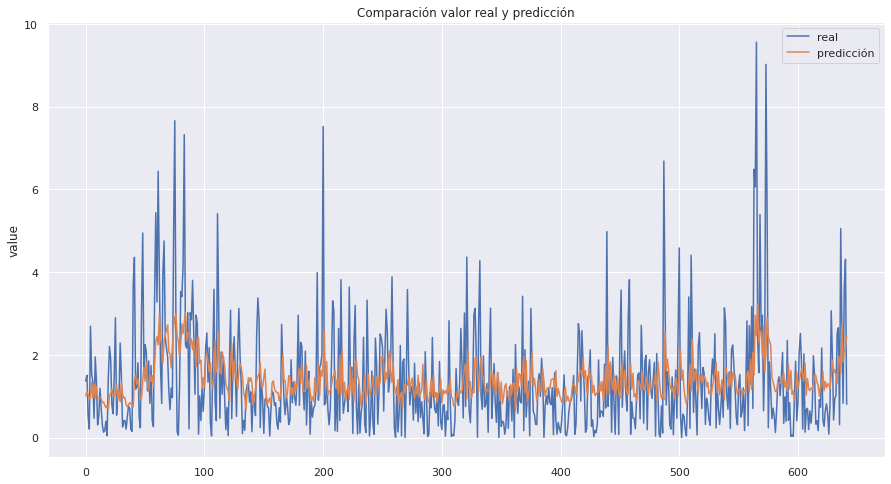

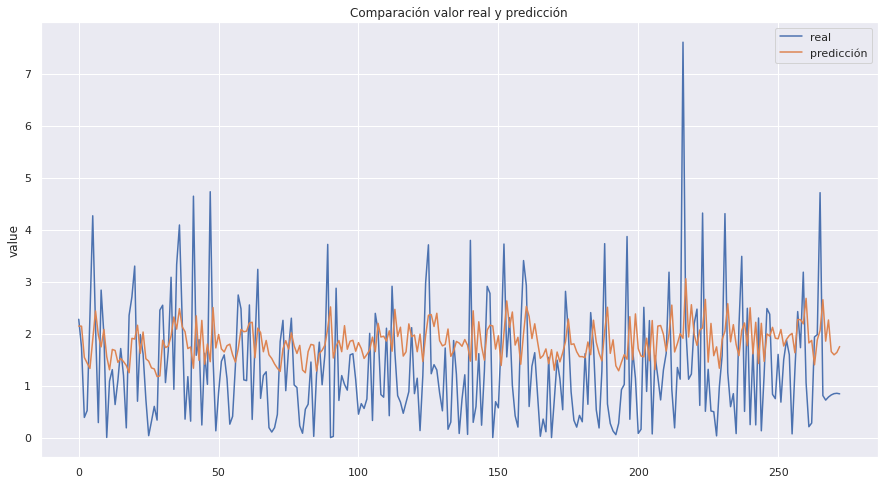

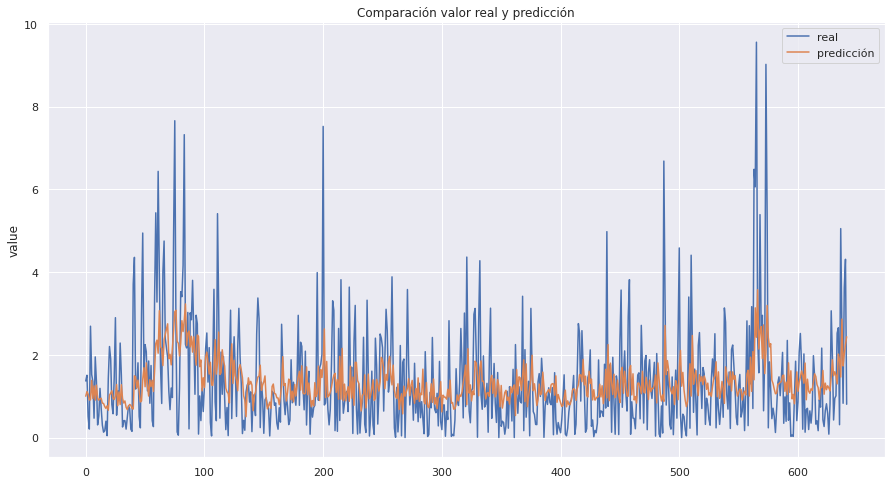

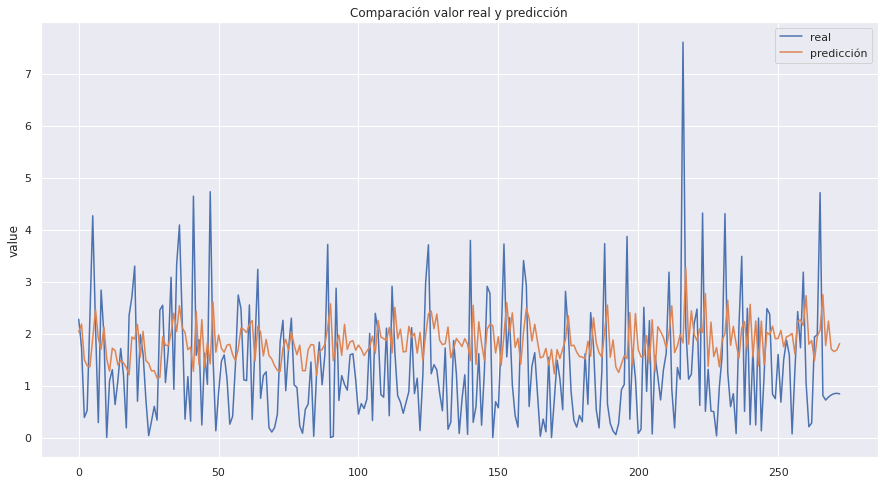

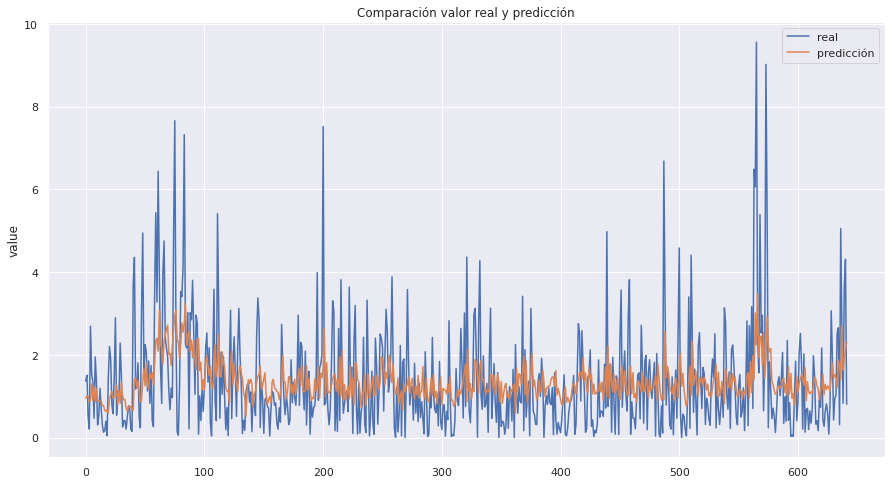

...

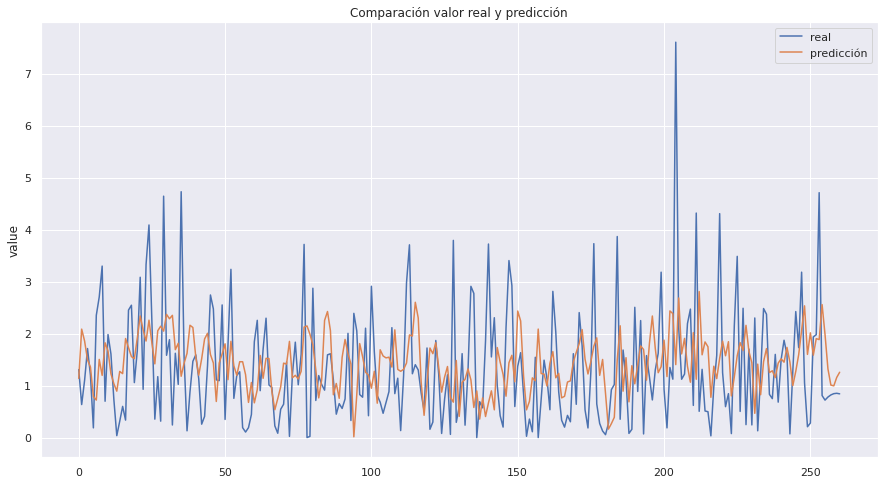

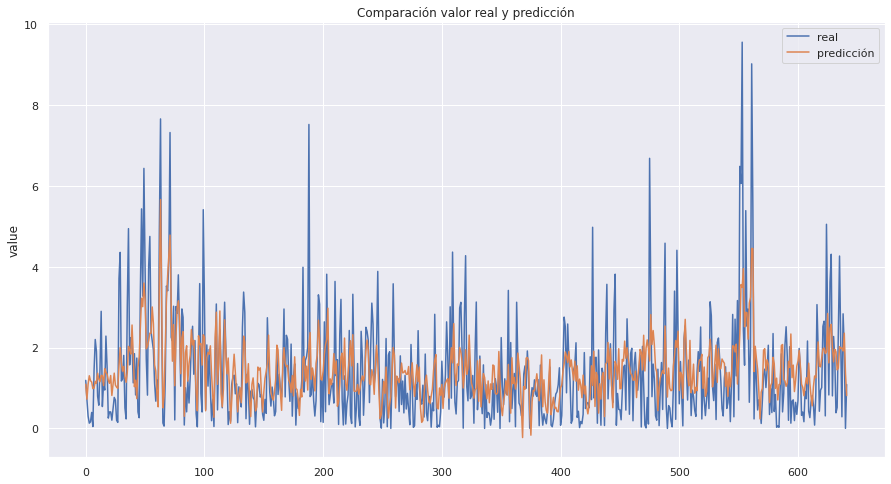

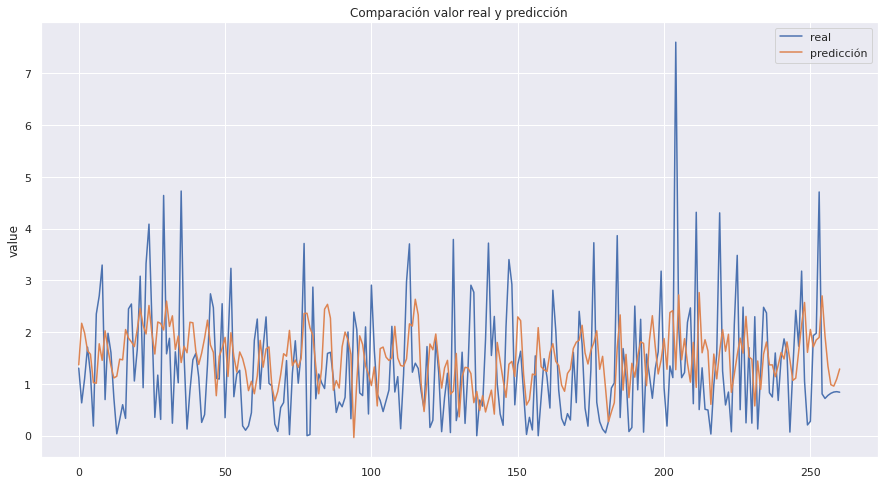

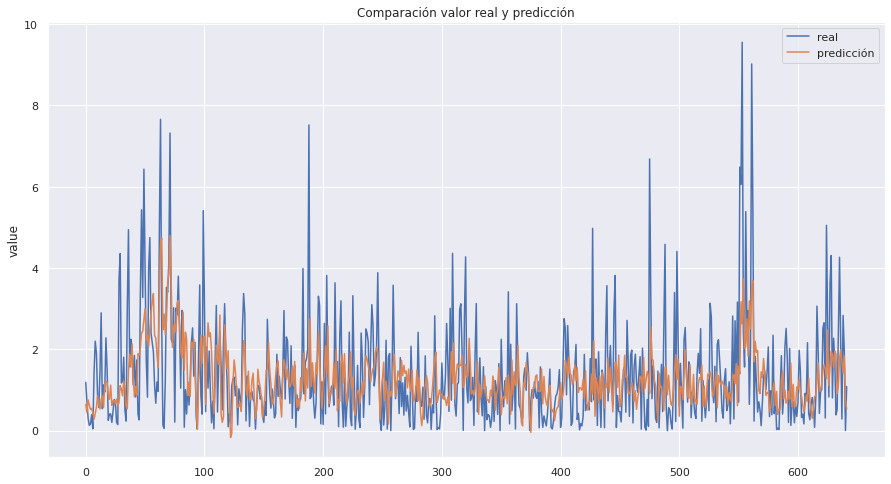

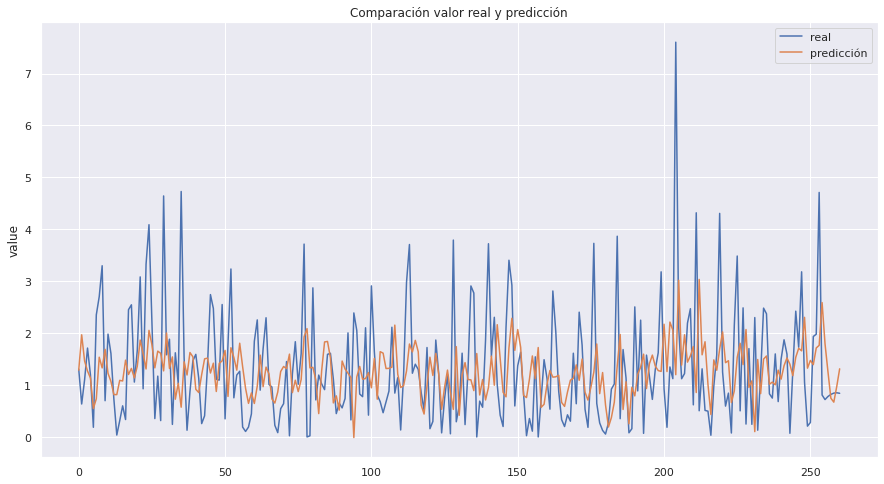

In [11]:
lags=[3,5,7,8,10,15]
n_estimators=[i for i in range(10,100,10)]
n_estimators.extend([200,300,500,2000])
results_models={i:{} for i in lags}
for lg in lags:
    for est in n_estimators:
        results_models[lg][est]=Model(df_data.copy(),df_label.copy(),lg,est)